# ***Import Libraries***




In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from sklearn.datasets import make_swiss_roll
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchsummary import summary
import math


# ***Creating the dataset***

In [2]:
# Sample a batch from the swiss roll
def sample_batch(size, noise=0.5):
    X, y = make_swiss_roll(size, noise=noise)
    print("X_shape: " + str(X.shape))
    print("X: " + str(X))
    print("y_shape: " + str(y.shape))
    print("y: " + str(y))
    X_2d_norm = X[:, [0, 2]]
    print("X_2d_norm.shape" + str(X_2d_norm.shape))
    print("X_2d_norm: " + str(X_2d_norm))
    return X_2d_norm
    

In [5]:
batch_size = 128
n_datapoints = 5120
# n_datapoints = 1280
# n_datapoints = 128*80 # 10240
# n_datapoints = 12800

In [6]:
data = sample_batch(n_datapoints).T # batch size = 128, so taking multiple of that. it would be easier to accumulate data later on
print()
print("data_shape: " + str(data.shape))
print("data: " + str(data))
print()
print(*data)


X_shape: (10240, 3)
X: [[ -7.36525327   8.20288422   4.83719089]
 [  5.87473876  11.76927431   0.86057188]
 [  6.42225251   1.76465381  -0.65316135]
 ...
 [  2.83208215  18.82845924  -4.19218684]
 [  4.69168509  14.56171552 -10.79066311]
 [ -6.32684392  18.44823928  -7.68035028]]
y_shape: (10240,)
y: [ 8.71061046  6.59606225  6.21948416 ...  5.31070897 11.38326907
 10.28498504]
X_2d_norm.shape(10240, 2)
X_2d_norm: [[ -7.36525327   4.83719089]
 [  5.87473876   0.86057188]
 [  6.42225251  -0.65316135]
 ...
 [  2.83208215  -4.19218684]
 [  4.69168509 -10.79066311]
 [ -6.32684392  -7.68035028]]

data_shape: (2, 10240)
data: [[ -7.36525327   5.87473876   6.42225251 ...   2.83208215   4.69168509
   -6.32684392]
 [  4.83719089   0.86057188  -0.65316135 ...  -4.19218684 -10.79066311
   -7.68035028]]

[-7.36525327  5.87473876  6.42225251 ...  2.83208215  4.69168509
 -6.32684392] [  4.83719089   0.86057188  -0.65316135 ...  -4.19218684 -10.79066311
  -7.68035028]


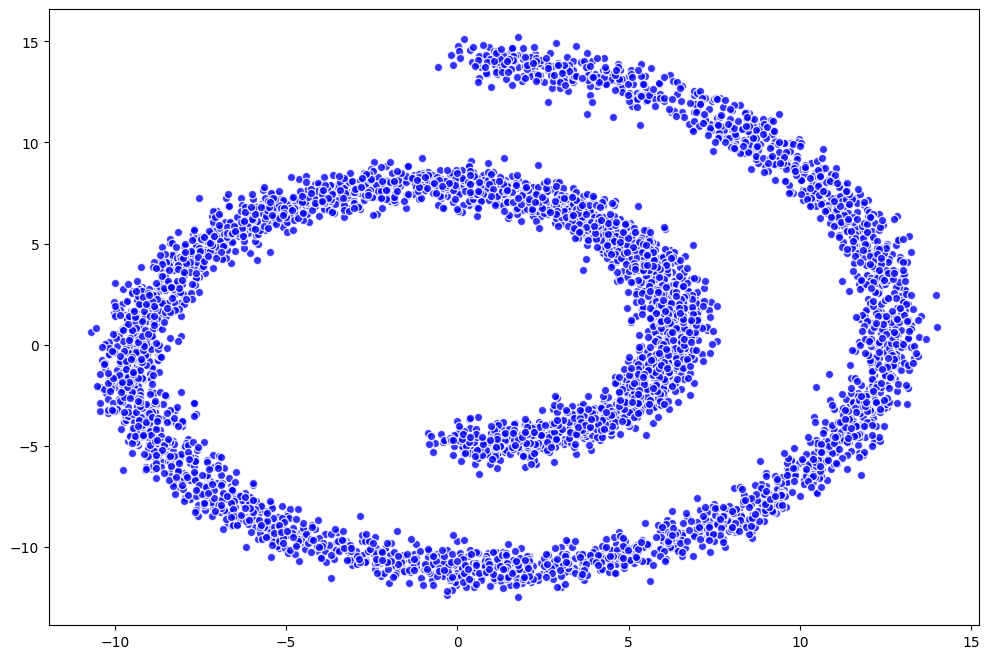

In [39]:
plt.figure(figsize=(12, 8))
plt.scatter(*data, alpha=0.8, color='blue', edgecolor='white');

In [40]:
dataset = torch.Tensor(data.T).float()
print(dataset.size())
print(dataset)

torch.Size([5120, 2])
tensor([[ 6.7783, -0.7517],
        [ 6.0336,  3.9185],
        [ 1.8670,  6.0986],
        ...,
        [-3.9290,  7.6328],
        [-9.4507,  1.6652],
        [ 6.7780, -9.1515]])


# ***Defining no. of timesteps***

In [68]:
# x0, x1, x2, ..., x99, 100 steps 
n_time_steps = 100


# ***Defining beta schedulers***

In [69]:
def beta_scheduler(schedule='linear', n_timesteps=1000, start=1e-5, end=1e-2):
    if schedule == 'linear':
        betas = torch.linspace(start, end, n_timesteps)
    elif schedule == "quad":
        betas = torch.linspace(start ** 0.5, end ** 0.5, n_time_steps)** 2
    elif schedule == "sigmoid":
        betas = torch.linspace(-6, 6, n_timesteps)
        betas = torch.sigmoid(betas) * (end - start) + start
    elif schedule == "cosine":
        cosine_cons = 5e-3
        timesteps = torch.arange(n_timesteps + 1) / n_timesteps + cosine_cons
        pi_val = math.pi
        alphas = timesteps / (1 + cosine_cons) * pi_val / 2
        alphas = torch.cos(alphas).pow(2)
        alphas = alphas / alphas[0]
        alphas = alphas[1:] / alphas[:-1]
        betas = 1 - alphas
        betas = betas.clamp(max=0.999) # [0, 0.999]
    return betas

# ***Sigmoid Beta***

In [70]:
betas = beta_scheduler(schedule='sigmoid', n_timesteps=n_time_steps, start=1e-5, end=1e-2)
print(betas.size())
print(betas)


torch.Size([100])
tensor([3.4702e-05, 3.7876e-05, 4.1457e-05, 4.5496e-05, 5.0052e-05, 5.5190e-05,
        6.0983e-05, 6.7515e-05, 7.4879e-05, 8.3178e-05, 9.2530e-05, 1.0307e-04,
        1.1493e-04, 1.2830e-04, 1.4334e-04, 1.6026e-04, 1.7929e-04, 2.0069e-04,
        2.2474e-04, 2.5174e-04, 2.8205e-04, 3.1603e-04, 3.5411e-04, 3.9673e-04,
        4.4440e-04, 4.9765e-04, 5.5705e-04, 6.2322e-04, 6.9681e-04, 7.7850e-04,
        8.6902e-04, 9.6909e-04, 1.0795e-03, 1.2008e-03, 1.3340e-03, 1.4795e-03,
        1.6380e-03, 1.8100e-03, 1.9958e-03, 2.1957e-03, 2.4097e-03, 2.6376e-03,
        2.8790e-03, 3.1331e-03, 3.3990e-03, 3.6755e-03, 3.9611e-03, 4.2539e-03,
        4.5522e-03, 4.8537e-03, 5.1563e-03, 5.4578e-03, 5.7561e-03, 6.0489e-03,
        6.3345e-03, 6.6110e-03, 6.8769e-03, 7.1310e-03, 7.3724e-03, 7.6003e-03,
        7.8143e-03, 8.0142e-03, 8.2000e-03, 8.3720e-03, 8.5305e-03, 8.6760e-03,
        8.8092e-03, 8.9305e-03, 9.0409e-03, 9.1410e-03, 9.2315e-03, 9.3132e-03,
        9.3868e-03, 9.

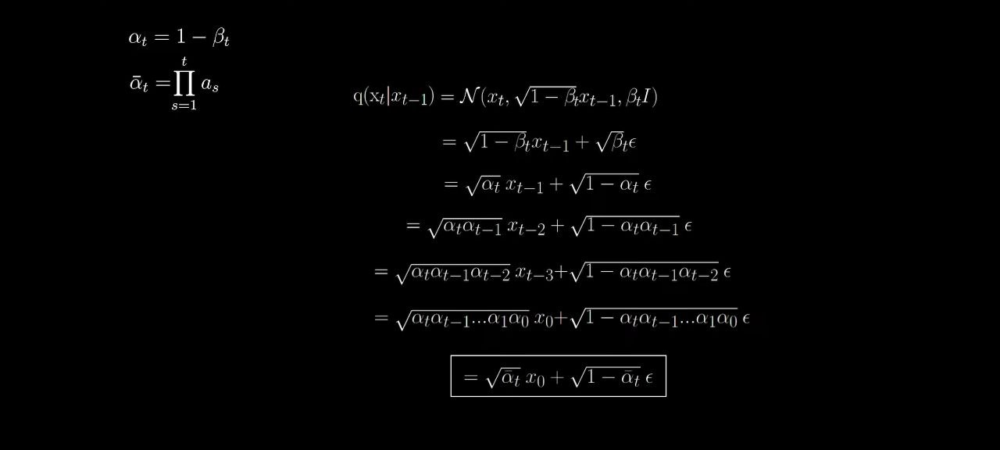

# ***Finding out alpha, ahpha bar etc.***

In [71]:
alphas = 1 - betas
alphas_prod = torch.cumprod(alphas, 0)
alphas_prod_p = torch.cat([torch.tensor([1]).float(), alphas_prod[:-1]], 0) # alpha_bar_t_minus_1
alphas_bar_sqrt = torch.sqrt(alphas_prod)
one_minus_alphas_bar_sqrt = torch.sqrt(1 - alphas_prod)

In [72]:
xx = torch.tensor([1]).float()
print(xx)
yy = alphas_prod[:-1]
print(yy.size())
print(yy)
zz = torch.cat([xx, yy], 0)
print(zz)

tensor([1.])
torch.Size([99])
tensor([1.0000, 0.9999, 0.9999, 0.9998, 0.9998, 0.9997, 0.9997, 0.9996, 0.9995,
        0.9994, 0.9994, 0.9993, 0.9991, 0.9990, 0.9989, 0.9987, 0.9985, 0.9983,
        0.9981, 0.9979, 0.9976, 0.9973, 0.9969, 0.9965, 0.9961, 0.9956, 0.9950,
        0.9944, 0.9937, 0.9929, 0.9921, 0.9911, 0.9900, 0.9888, 0.9875, 0.9861,
        0.9844, 0.9827, 0.9807, 0.9786, 0.9762, 0.9736, 0.9708, 0.9678, 0.9645,
        0.9609, 0.9571, 0.9531, 0.9487, 0.9441, 0.9393, 0.9341, 0.9287, 0.9231,
        0.9173, 0.9112, 0.9050, 0.8985, 0.8919, 0.8851, 0.8782, 0.8711, 0.8640,
        0.8568, 0.8495, 0.8421, 0.8347, 0.8272, 0.8197, 0.8122, 0.8047, 0.7972,
        0.7898, 0.7823, 0.7749, 0.7674, 0.7601, 0.7527, 0.7454, 0.7382, 0.7310,
        0.7238, 0.7167, 0.7097, 0.7027, 0.6958, 0.6889, 0.6821, 0.6753, 0.6686,
        0.6620, 0.6554, 0.6489, 0.6424, 0.6360, 0.6297, 0.6234, 0.6172, 0.6110])
tensor([1.0000, 1.0000, 0.9999, 0.9999, 0.9998, 0.9998, 0.9997, 0.9997, 0.9996,
        0

In [73]:
print("alphas: " + str(alphas))
print("alphas_prod: " + str(alphas_prod))
print("alphas_prod_p: " + str(alphas_prod_p)) # # alpha_bar_t_minus_1, got from ddpm equation for mean, var
print("alphas_bar_sqrt: " + str(alphas_bar_sqrt))
print("one_minus_alphas_bar_sqrt: " + str(one_minus_alphas_bar_sqrt))

alphas: tensor([1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998, 0.9998,
        0.9998, 0.9997, 0.9997, 0.9997, 0.9996, 0.9996, 0.9996, 0.9995, 0.9994,
        0.9994, 0.9993, 0.9992, 0.9991, 0.9990, 0.9989, 0.9988, 0.9987, 0.9985,
        0.9984, 0.9982, 0.9980, 0.9978, 0.9976, 0.9974, 0.9971, 0.9969, 0.9966,
        0.9963, 0.9960, 0.9957, 0.9954, 0.9951, 0.9948, 0.9945, 0.9942, 0.9940,
        0.9937, 0.9934, 0.9931, 0.9929, 0.9926, 0.9924, 0.9922, 0.9920, 0.9918,
        0.9916, 0.9915, 0.9913, 0.9912, 0.9911, 0.9910, 0.9909, 0.9908, 0.9907,
        0.9906, 0.9905, 0.9905, 0.9904, 0.9904, 0.9903, 0.9903, 0.9903, 0.9902,
        0.9902, 0.9902, 0.9902, 0.9902, 0.9901, 0.9901, 0.9901, 0.9901, 0.9901,
        0.9901, 0.9901, 0.9901, 0.9901, 0.9900, 0.9900, 0.9900, 0.9900, 0.9900,
        0.9900])
alphas_prod: tensor([1.0000, 0.9999, 0.9999, 0.9998, 0.9998, 0.9997, 0.9997, 0.9996, 0.9995,
  

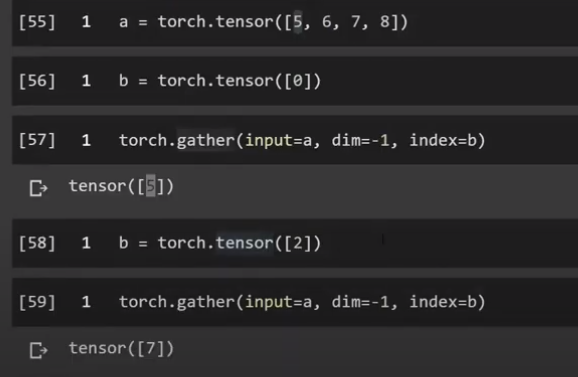

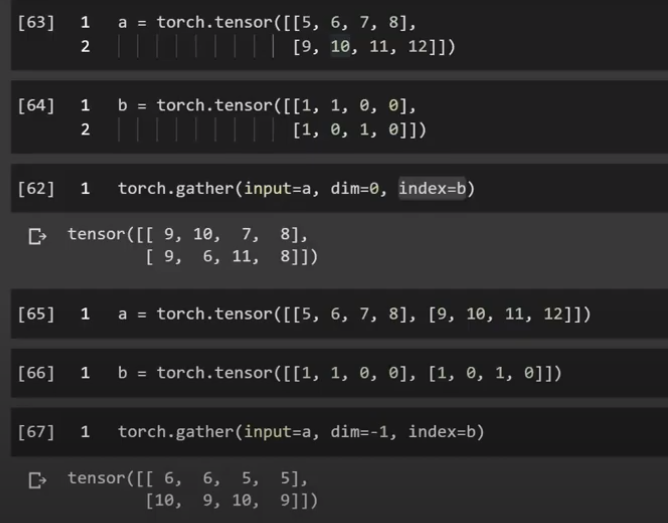

# ***Extract the cumulative product at timestep t and then redimension the input as the dimension of input_2***

In [74]:
# Extracting input at timestamp = t and then reshaping according to the dimesion of x
def extract_and_redimension(input, t, input_2):
    input_at_t = torch.gather(input, 0, t.to(input.device))
    reshape = [t.shape[0]] + [1] * (len(input_2.shape) - 1)
    return input_at_t.reshape(*reshape)


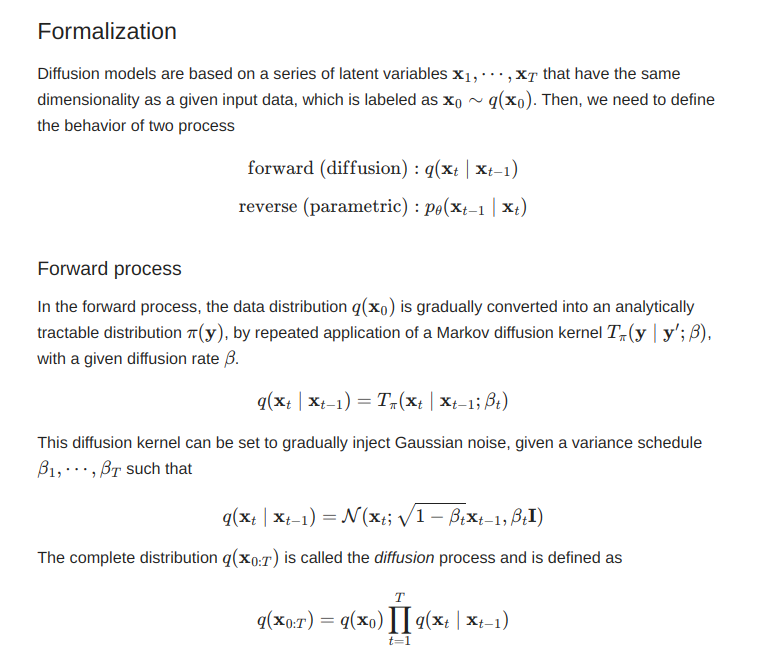

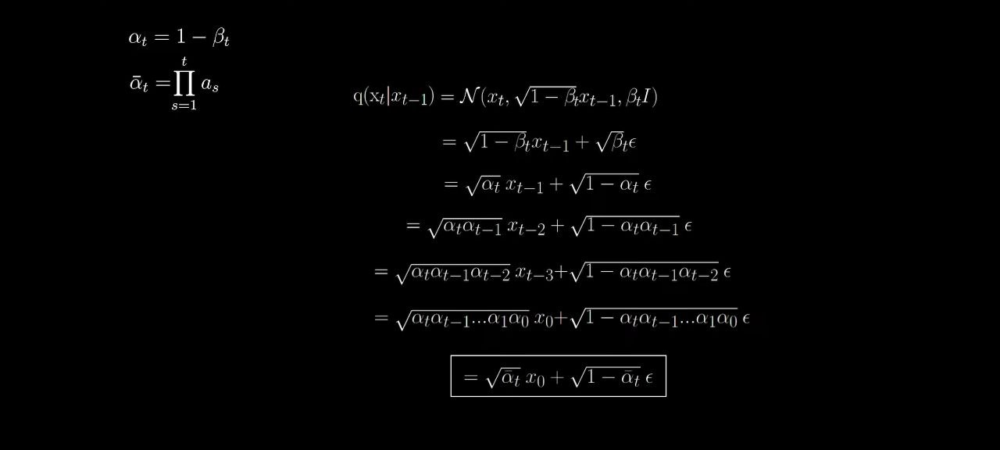

# ***Forward Process of adding Noise***

In [75]:
def q_sample(x_0, t, noise=None):
    if noise is None:
        noise = torch.randn_like(x_0) # random noise like input data, same dimesnion
    else:
        pass
    # print("alphas_bar_sqrt: " + str(alphas_bar_sqrt))
    alphas_bar_sqrt_cumulative_t = extract_and_redimension(alphas_bar_sqrt, t, x_0) # product of alphas_bar_sqrt upto th term, let's say t=5, we've cumulative product stored in array, so pick the 5th term, and tweak acc to dimension
    # print("alphas_bar_sqrt_cumulative_t: " + str(alphas_bar_sqrt_cumulative_t))
    # print("one_minus_alphas_bar_sqrt: " + str(one_minus_alphas_bar_sqrt))
    one_minus_alphas_bar_sqrt_cumulative_t = extract_and_redimension(one_minus_alphas_bar_sqrt, t, x_0) # product of one_minus_alphas_bar_sqrt upto th term, eg. for t=5, we've cumulative product stored in array, so pick the 5th term, and tweak acc to dimension
    # print("one_minus_alphas_bar_sqrt_cumulative_t: " + str(one_minus_alphas_bar_sqrt_cumulative_t))
    return (alphas_bar_sqrt_cumulative_t * x_0 + one_minus_alphas_bar_sqrt_cumulative_t * noise)


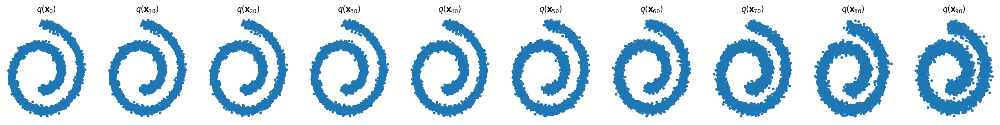

In [76]:
fig, axs = plt.subplots(1, 10, figsize=(28, 3))

for i in range(10):
    time_steps = torch.tensor([i * 10])
    x_i = q_sample(dataset, time_steps)
    axs[i].scatter(x_i[:, 0], x_i[:, 1], s=10);
    axs[i].set_axis_off(); axs[i].set_title('$q(\mathbf{x}_{'+str(i*10)+'})$')

- ***Given x0 and xt, we need to find out the mean and variance. The following fomula achieves this***

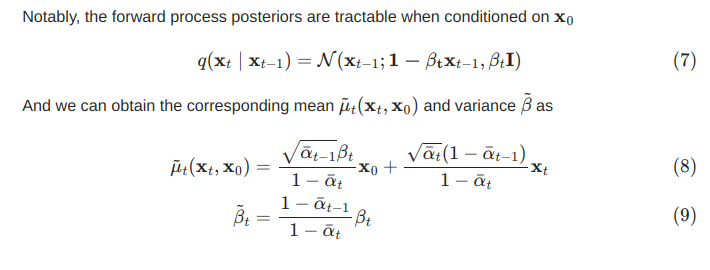

# ***Given x0 and xt, find mean and variance from them***

In [77]:
prod_alphas_t_minus_1 = alphas_prod_p
coef_1_num = (torch.sqrt(prod_alphas_t_minus_1) * betas)
coef_1_deno = 1 - alphas_prod
posterior_mean_coef_1 = coef_1_num / coef_1_deno
# posterior_mean_coef_1 = (betas * torch.sqrt(alphas_prod_p) / (1 - alphas_prod))

coef_2_num = torch.sqrt(alphas) * (1 - prod_alphas_t_minus_1)
coef_2_deno = 1 - alphas_prod
posterior_mean_coef_2 = coef_2_num / coef_2_deno
# posterior_mean_coef_2 = ((1 - alphas_prod_p) * torch.sqrt(alphas) / (1 - alphas_prod))

posterior_variance_num = betas * (1 - prod_alphas_t_minus_1)
posterior_variance_deno = (1 - alphas_prod)
posterior_variance = posterior_variance_num / posterior_variance_deno
# posterior_variance = betas * (1 - prod_alphas_t_minus_1) / (1 - alphas_prod)
posterior_log_variance_clipped = torch.log(torch.cat((posterior_variance[1].view(1, 1), posterior_variance[1:].view(-1, 1)), 0)).view(-1)
                                                                                 

In [78]:
# given x0 and xt, find mean and variance from them
def q_posterior_mean_variance(x_0, x_t, t):
    # Calculating Mean
    posterior_mean_coef_1_at_t_redimension = extract_and_redimension(posterior_mean_coef_1, t, x_0)
    posterior_mean_coef_2_at_t_redimension = extract_and_redimension(posterior_mean_coef_2, t, x_0)
    first_term = posterior_mean_coef_1_at_t_redimension * x_0
    second_term = posterior_mean_coef_2_at_t_redimension * x_t
    mean = first_term + second_term

    # Calculating Variance
    var = extract_and_redimension(posterior_log_variance_clipped, t, x_0)
    return mean, var


# ***Defining the model***

In [79]:
import torch.nn.functional as F
class ConditionalLinear(nn.Module):
    def __init__(self, num_in, num_out, n_steps):
        super(ConditionalLinear, self).__init__()
        self.num_out = num_out
        self.lin = nn.Linear(num_in, num_out)
        self.embed = nn.Embedding(n_steps, num_out)
        self.embed.weight.data.uniform_()

    def forward(self, x, y):
        out = self.lin(x)
        gamma = self.embed(y)
        out = gamma.view(-1, self.num_out) * out
        return out
class ConditionalModel(nn.Module):
    def __init__(self, n_steps):
        super(ConditionalModel, self).__init__()
        self.lin1 = ConditionalLinear(2, 128, n_steps)
        self.lin2 = ConditionalLinear(128, 128, n_steps)
        self.lin3 = nn.Linear(128, 4)
    
    def forward(self, x, y):
        x = F.softplus(self.lin1(x, y))
        x = F.softplus(self.lin2(x, y))
        return self.lin3(x)


# ***Reverse Process***

In [80]:
# Given xt and t find out the mean and variance calculated by model
def p_mean_variance(model, x, t):
    # Go through model
    model_output = model(x, t)
    # Extract the mean and variance
    mean, log_var = torch.split(model_output, 2, dim=-1)
    noise = mean + log_var
    return mean, log_var

# Given t and xt, finding out xt-t = xt-t
def p_sample(model, x, t):
    t_tensor = torch.tensor(t)
    mean, log_var = p_mean_variance(model, x, t_tensor)
    actual_var = torch.exp(0.5 * log_var)
    rand_noise = torch.randn_like(x)
    sample = mean + actual_var * rand_noise
    return (sample) 

def p_sample_loop(model, shape):
    random_noise = torch.randn(shape)
    # cur_data = [random_noise]
    reverse_process_data_at_diff_time = [random_noise]
    for i in range(n_time_steps-1, -1, -1):
        random_noise = p_sample(model, random_noise, i)
        reverse_process_data_at_diff_time.append(random_noise)
        # out_x = p_sample(model, cur_data, i)
        # x_seq.append(out_x)
    return reverse_process_data_at_diff_time

# ***Formulas kl-div and entropy***

In [81]:
def kl_divergence(mean1, logvar1, mean2, logvar2):
    kl = 0.5 * (-1.0 + logvar2 - logvar1 + torch.exp(logvar1 - logvar2) + ((mean1 - mean2) ** 2) * torch.exp(-logvar2))
    return kl

def entropy(val):
    return (0.5 * (1 + np.log(2. * np.pi))) + 0.5 * np.log(val)

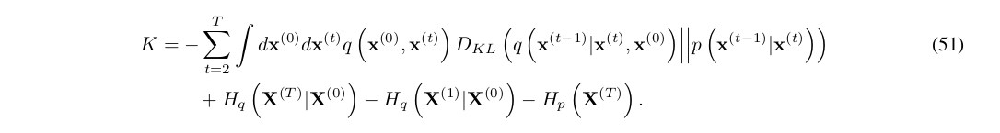

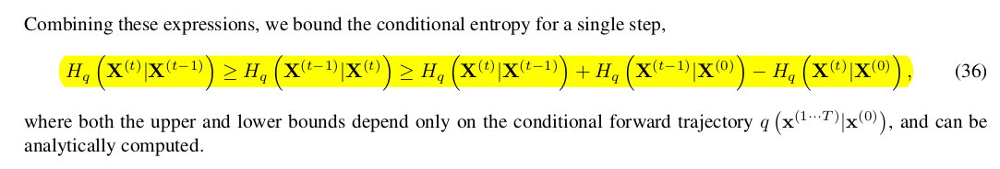

# ***Defining Loss function***

In [82]:
def calculate_loss(true_mean, true_var, model_mean, model_var):
    # the KL divergence between model transition and posterior from data
    KL = kl_divergence(true_mean, true_var, model_mean, model_var).float()
    
    # conditional entropies H_q(x^T|x^0) and H_q(x^1|x^0)
    H_start = entropy(betas[0].float())
    H_start = H_start.float()
    one_minus_exp_sum_of_log_alphas = 1. - torch.exp(torch.sum(torch.log(alphas))).float()
    H_end = entropy(one_minus_exp_sum_of_log_alphas.float())
    H_end = H_end.float()
    H_prior = entropy(torch.tensor([1.]))
    H_prior = H_prior.float()
    
    # Actual Loss Function
    negL_bound = n_time_steps * KL + H_start - H_end + H_prior

    # the negL_bound if this was an isotropic Gaussian model of the data
    negL_gauss = entropy(torch.tensor([1.])).float()
    negL_diff = negL_bound - negL_gauss
    L_diff_bits = negL_diff / np.log(2.)
    L_diff_bits_avg = L_diff_bits.mean()
    return L_diff_bits_avg

def loss_likelihood_bound(model, x_0):
    batch_size = x_0.shape[0]
    # Select a random step for each example
    t = torch.randint(0, n_time_steps, size=(batch_size // 2 + 1,))
    t = torch.cat([t, n_time_steps - t - 1], dim=0)[:batch_size].long()
    # t = torch.randint(0, n_time_steps, size=(batch_size,)).long()

    # Perform diffusion for step t, x0 -> xt
    x_t = q_sample(x_0, t)

    # Compute the true mean and variance
    true_mean, true_var = q_posterior_mean_variance(x_0, x_t, t)
    # Infer the mean and variance with our model
    model_mean, model_var = p_mean_variance(model, x_t, t)
    # Compute the loss
    total_loss = calculate_loss(true_mean, true_var, model_mean, model_var)

    # return total_loss and data at t=t i.e. xt
    return total_loss, x_t

In [22]:
# x_t = q_sample(x_0, t)
# x_recon = model(x_t, t)
# return F.mse_loss(x_recon, noise)

# ***Defining function for plotting epochs vs Loss***

In [83]:
import matplotlib.pyplot as plt

def my_plot(epochs, loss, x_label, y_label, title):
    plt.plot(epochs, loss)

    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.show()

# ***ADAM optimizer with lr = 1e-3***

In [84]:
dataset = torch.tensor(data.T).float()
model = ConditionalModel(n_time_steps)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
batch_size = 128
n_epochs = 10001

tensor(441.3799, grad_fn=<MeanBackward0>)
tensor(47.0368, grad_fn=<MeanBackward0>)
tensor(39.6782, grad_fn=<MeanBackward0>)
tensor(50.6556, grad_fn=<MeanBackward0>)
tensor(42.3937, grad_fn=<MeanBackward0>)
tensor(43.3973, grad_fn=<MeanBackward0>)
tensor(40.4870, grad_fn=<MeanBackward0>)
tensor(39.2022, grad_fn=<MeanBackward0>)
tensor(39.9992, grad_fn=<MeanBackward0>)
tensor(33.5111, grad_fn=<MeanBackward0>)
tensor(37.8390, grad_fn=<MeanBackward0>)


<ipython-input-86-032a40c7edec>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 8))


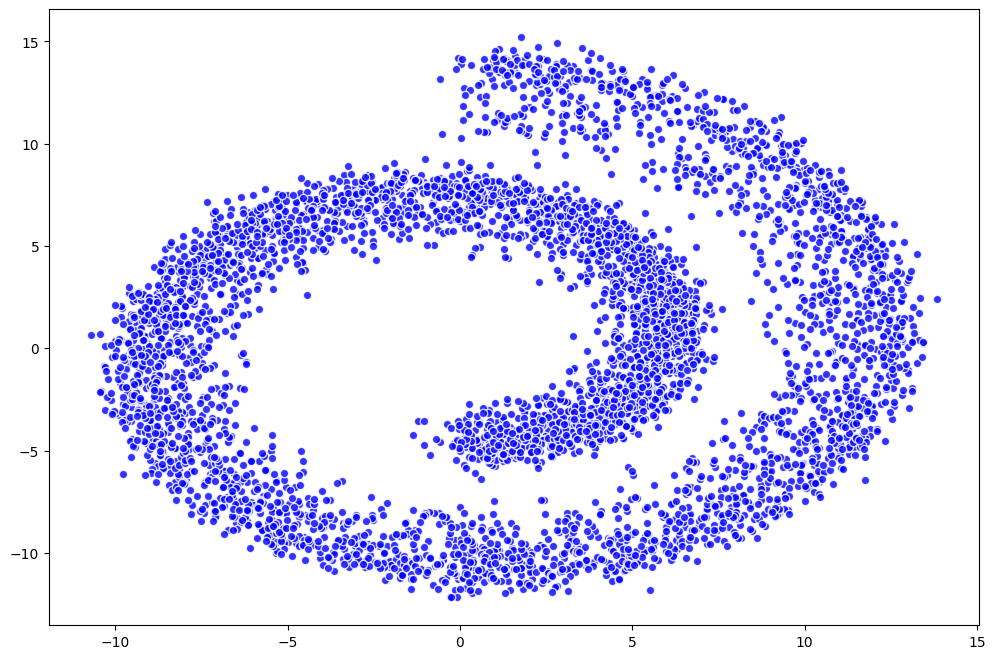

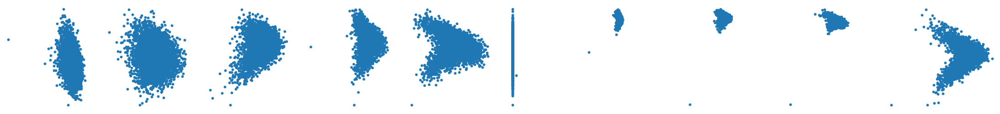

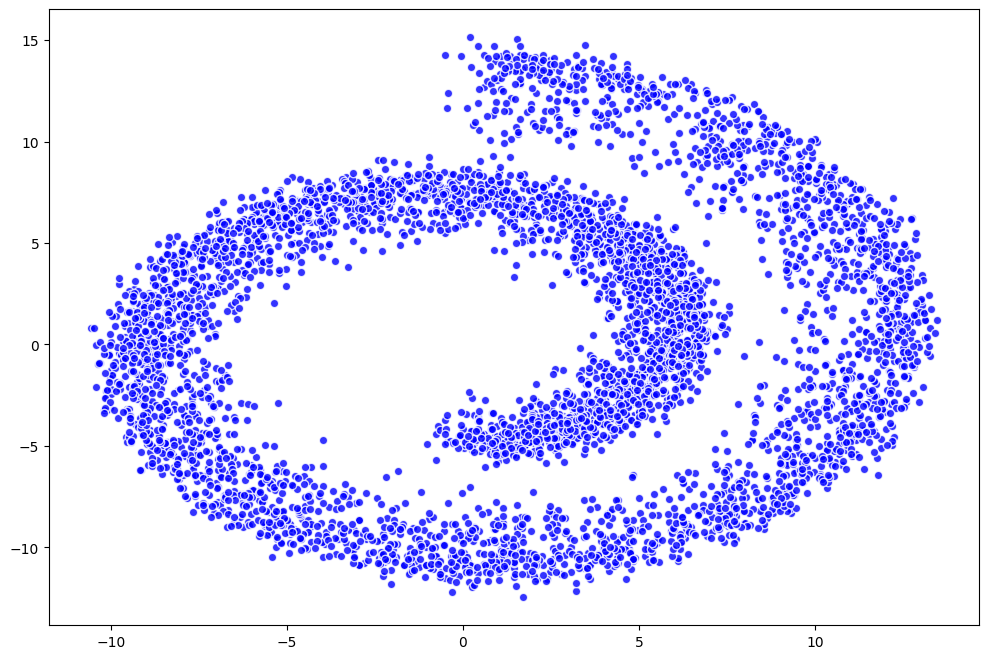

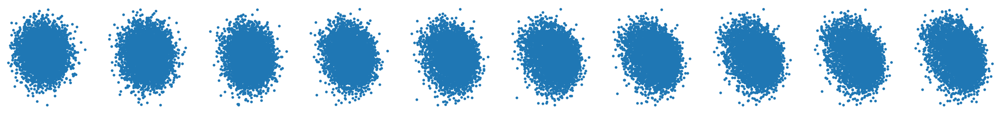

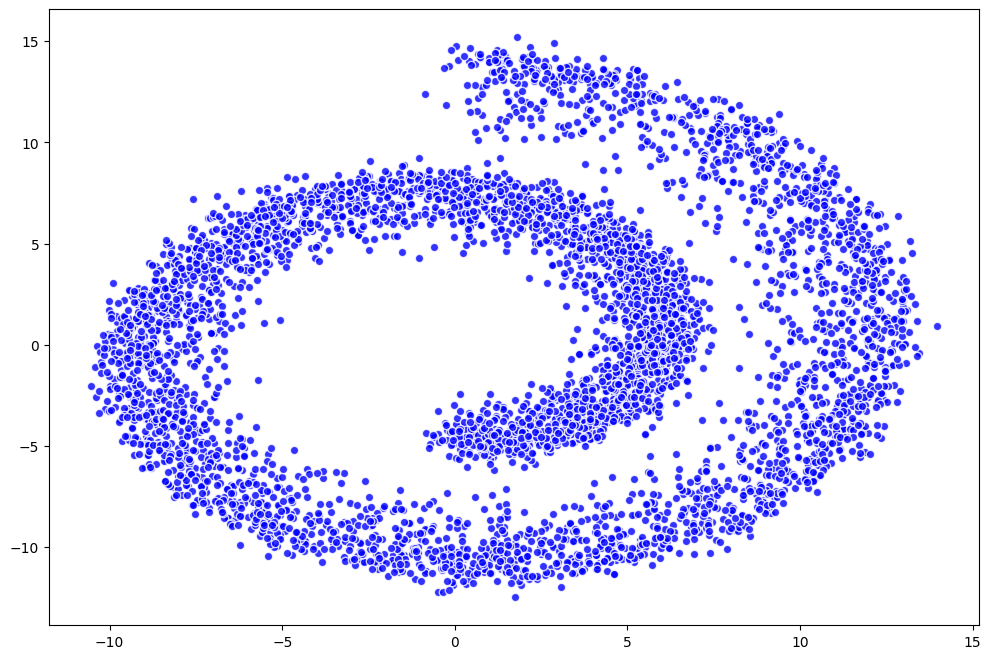

...

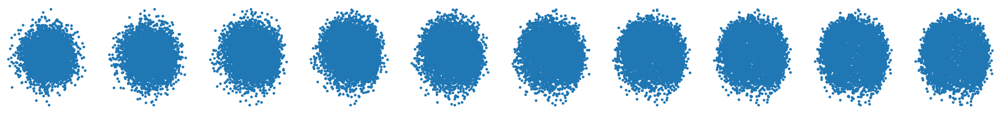

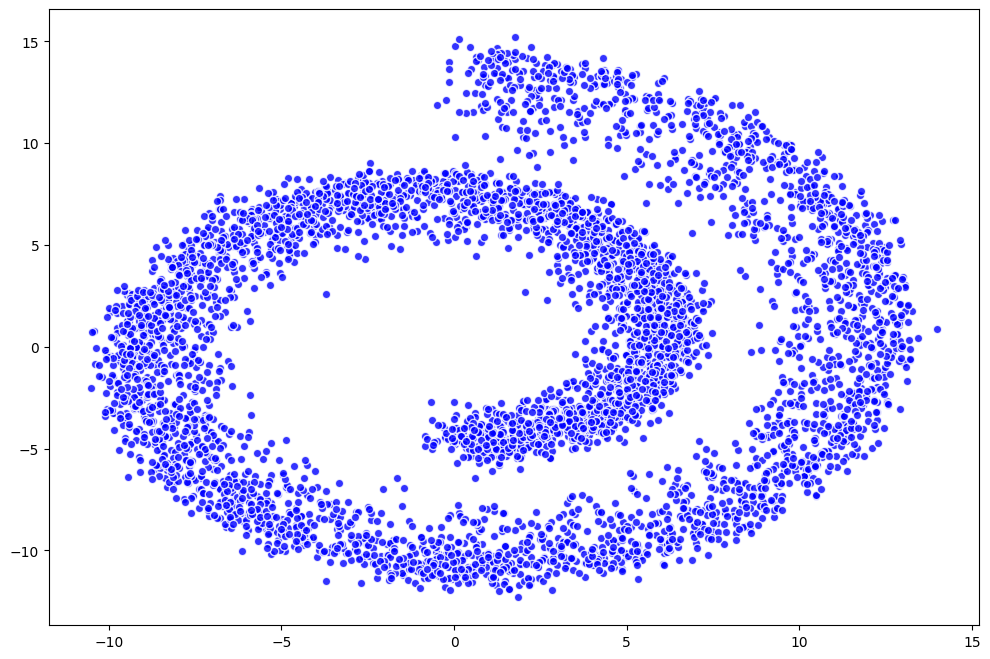

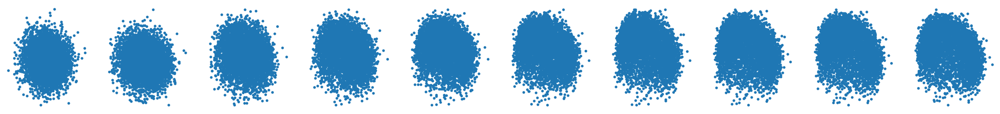

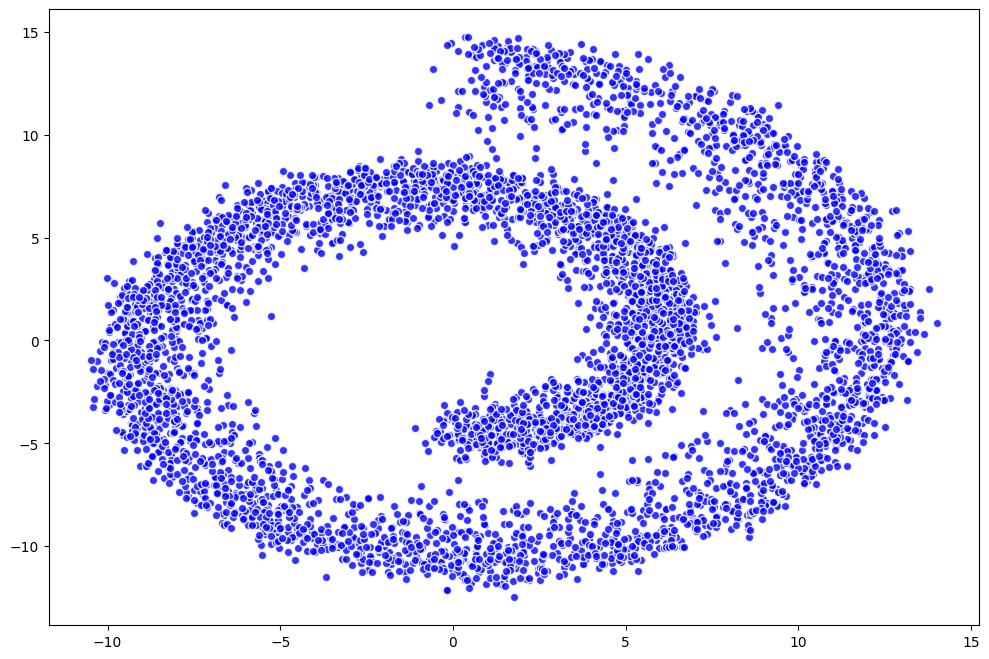

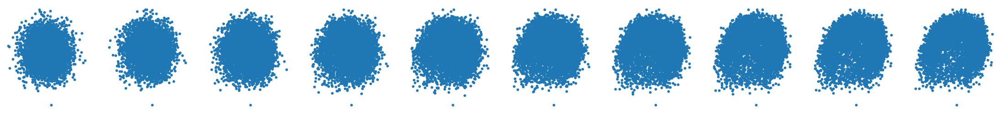

In [86]:
# 1 hr 17 mins to run

loss_vals=  []
for t in range(n_epochs):
    # plt.figure(figsize=(12, 8))
    # plt.scatter(*dataset.T, alpha=0.8, color='blue', edgecolor='white');
    noisy_data = torch.empty(0,2)
    epoch_loss= []
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, x_t = loss_likelihood_bound(model, batch_x)
        noisy_data = torch.cat((noisy_data, x_t), 0)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        epoch_loss.append(loss.item())
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
    if (t % 100 == 0):
        loss_vals.append(sum(epoch_loss)/len(epoch_loss))
    # Print loss
    if (t % 1000 == 0):
        print("Loss at epoch " + str(t) + ": " + str(loss.item()))
        plt.figure(figsize=(12, 8))
        plt.scatter(*noisy_data.T, alpha=0.8, color='blue', edgecolor='white');
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); # axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')

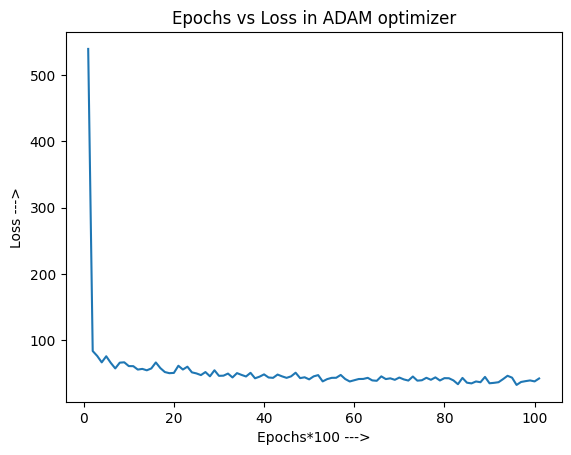

In [88]:
x_label = "Epochs*100 --->"
y_label = "Loss --->"
title = "Epochs vs Loss in ADAM optimizer"
my_plot(np.linspace(1, len(loss_vals), len(loss_vals)).astype(int), loss_vals, x_label, y_label, title)

# ***SGD optimizer with lr=1e-3 momentum = 0.9***

In [ ]:
dataset = torch.tensor(data.T).float()
model = ConditionalModel(n_time_steps)
optimizer = optim.SGD(model.parameters(), lr=1e-3, momentum = 0.9)
batch_size = 128
n_epochs = 10001

tensor(925.5665, grad_fn=<MeanBackward0>)
tensor(53.5352, grad_fn=<MeanBackward0>)
tensor(43.8025, grad_fn=<MeanBackward0>)
tensor(36.9435, grad_fn=<MeanBackward0>)
tensor(31.2279, grad_fn=<MeanBackward0>)
tensor(30.8024, grad_fn=<MeanBackward0>)
tensor(29.4649, grad_fn=<MeanBackward0>)
tensor(31.9413, grad_fn=<MeanBackward0>)
tensor(22.7631, grad_fn=<MeanBackward0>)
tensor(15.9033, grad_fn=<MeanBackward0>)
tensor(18.2353, grad_fn=<MeanBackward0>)


<ipython-input-24-be5e929db7e6>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 8))


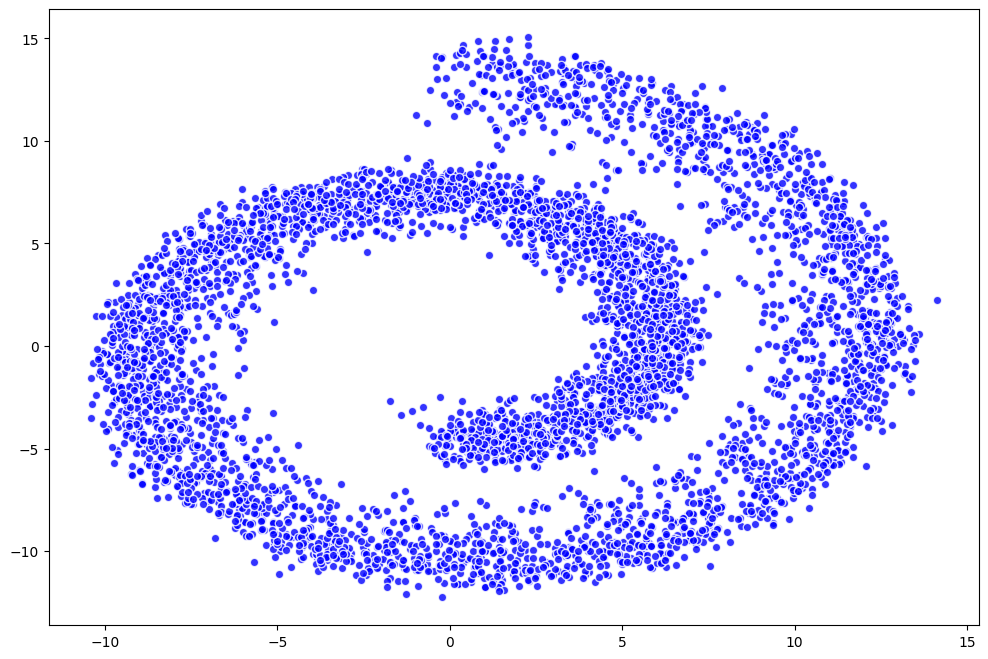

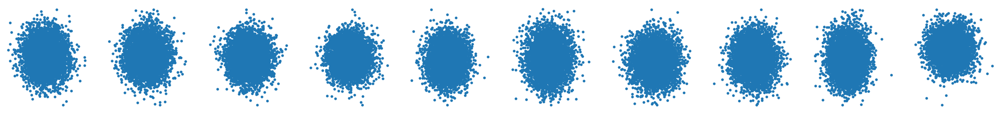

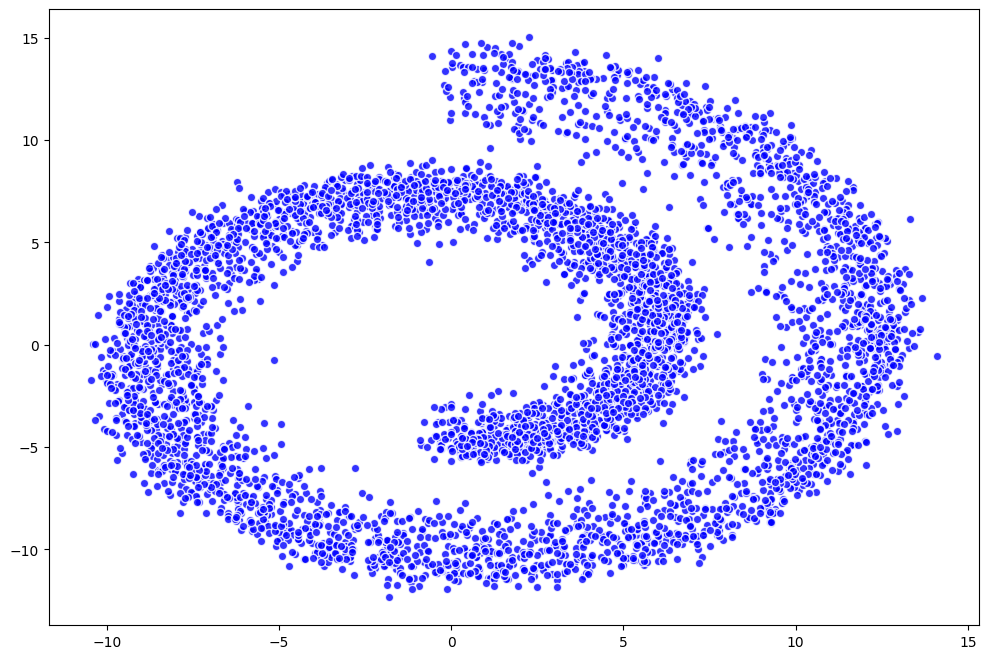

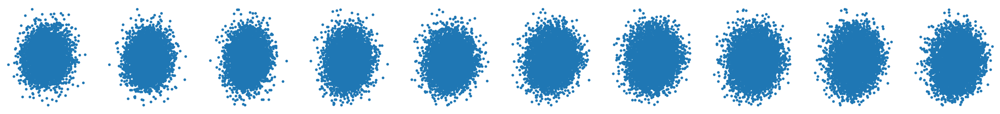

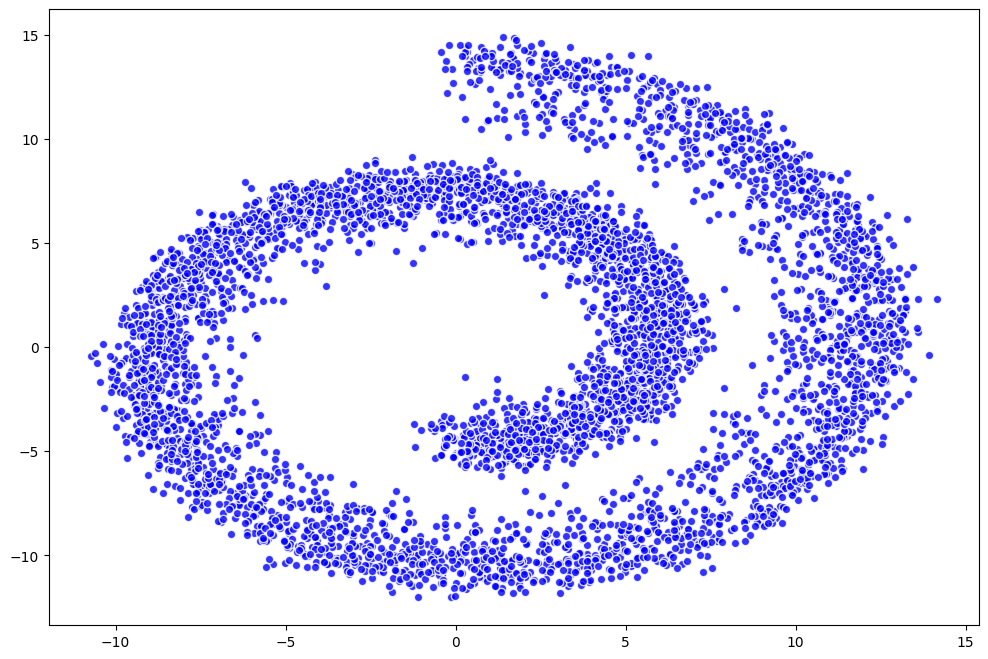

...

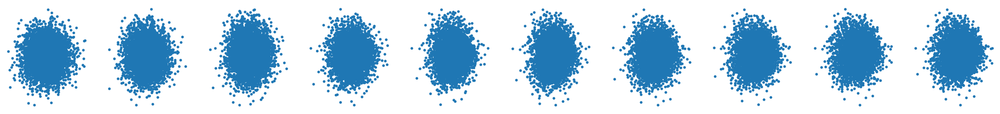

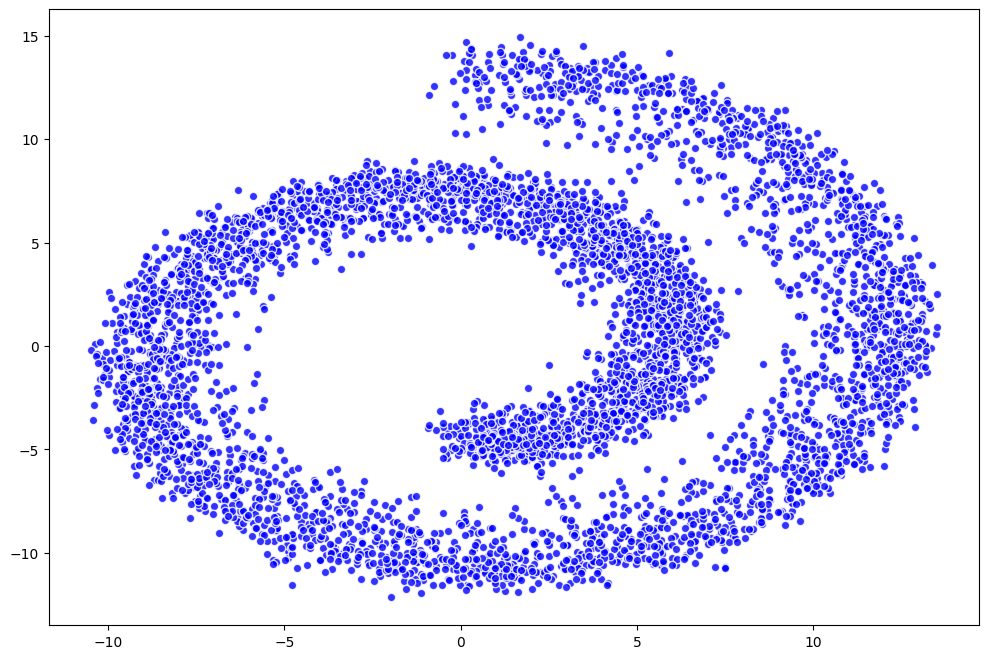

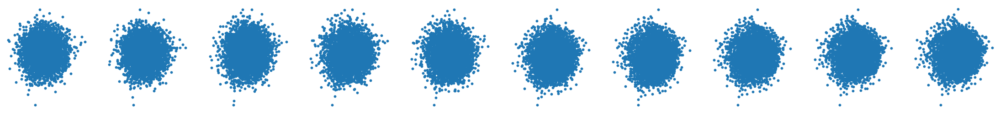

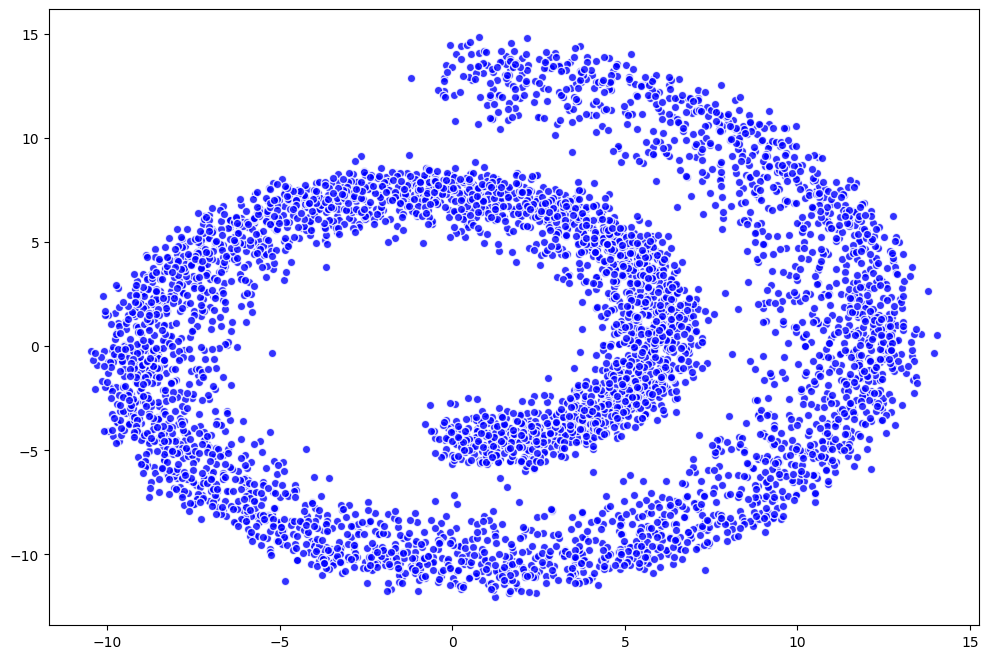

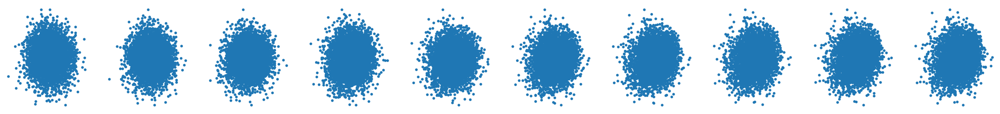

In [ ]:
# 1 hr 17 mins to run

SGD_loss_vals = []
for t in range(n_epochs):
    # plt.figure(figsize=(12, 8))
    # plt.scatter(*dataset.T, alpha=0.8, color='blue', edgecolor='white');
    noisy_data = torch.empty(0,2)
    epoch_loss= []
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, x_t = loss_likelihood_bound(model, batch_x)
        noisy_data = torch.cat((noisy_data, x_t), 0)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        epoch_loss.append(loss.item())
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
    if (t % 100 == 0):
        SGD_loss_vals.append(sum(epoch_loss)/len(epoch_loss))
    # Print loss
    if (t % 1000 == 0):
        print("Loss at epoch " + str(t) + ": " + str(loss.item()))
        plt.figure(figsize=(12, 8))
        plt.scatter(*noisy_data.T, alpha=0.8, color='blue', edgecolor='white');
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); # axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')

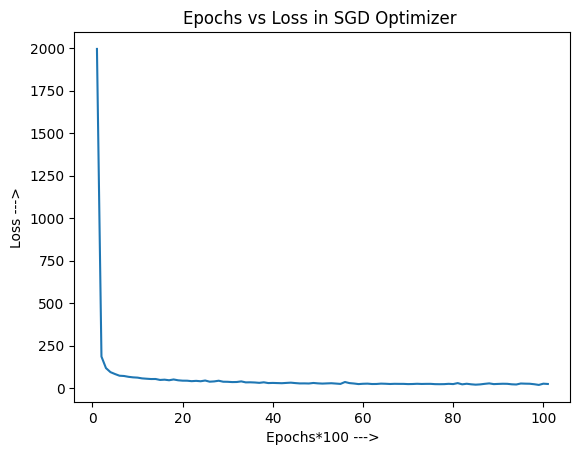

In [ ]:
x_label = "Epochs*100 --->"
y_label = "Loss --->"
title = "Epochs vs Loss in SGD Optimizer with momentum lr = 1e-3"
my_plot(np.linspace(1, len(SGD_loss_vals), len(SGD_loss_vals)).astype(int), SGD_loss_vals, x_label, y_label, title)

***SGD with momentum is performing better in decrementing loss***

# ***SGD optimizer with lr=1e-4 & momentum = 0.9***

In [91]:
dataset = torch.tensor(data.T).float()
model = ConditionalModel(n_time_steps)
optimizer = optim.SGD(model.parameters(), lr=1e-4, momentum = 0.9)
batch_size = 128
n_epochs = 10001

Loss at epoch 0: 2923.6669921875
Loss at epoch 1000: 167.10545349121094
Loss at epoch 2000: 98.92330932617188
Loss at epoch 3000: 74.55216979980469
Loss at epoch 4000: 68.25668334960938
Loss at epoch 5000: 71.91804504394531
Loss at epoch 6000: 59.17573928833008
Loss at epoch 7000: 59.3918571472168
Loss at epoch 8000: 57.14523696899414
Loss at epoch 9000: 46.965118408203125
Loss at epoch 10000: 48.79926300048828


<ipython-input-92-603cab341f72>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 8))


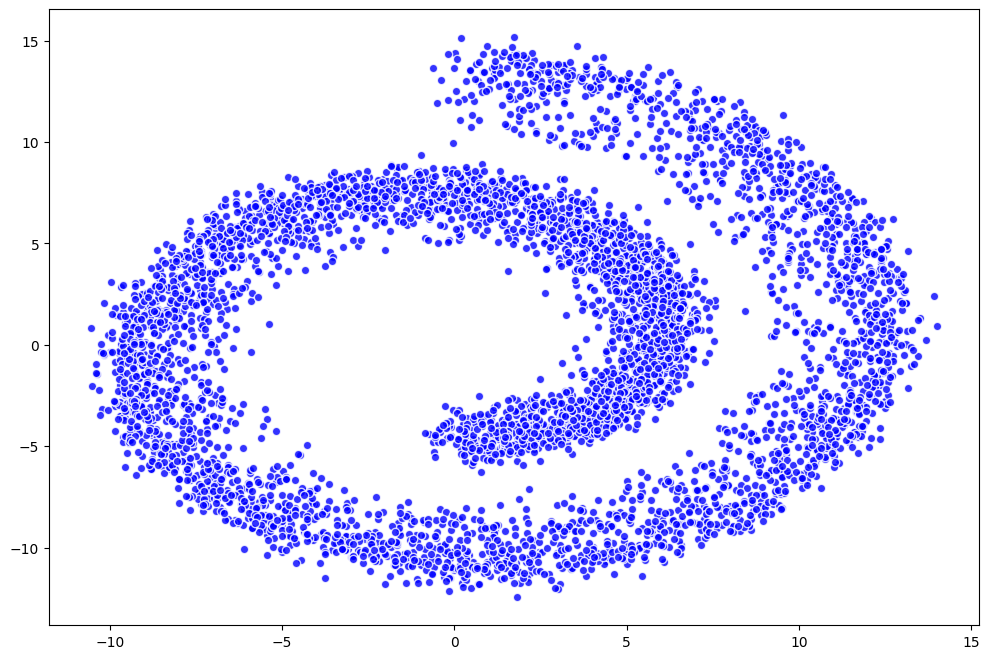

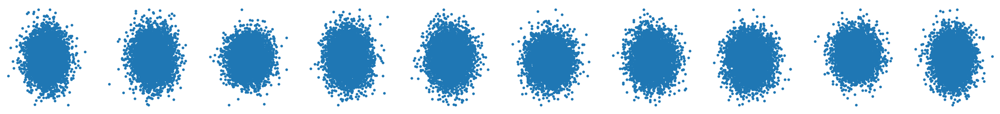

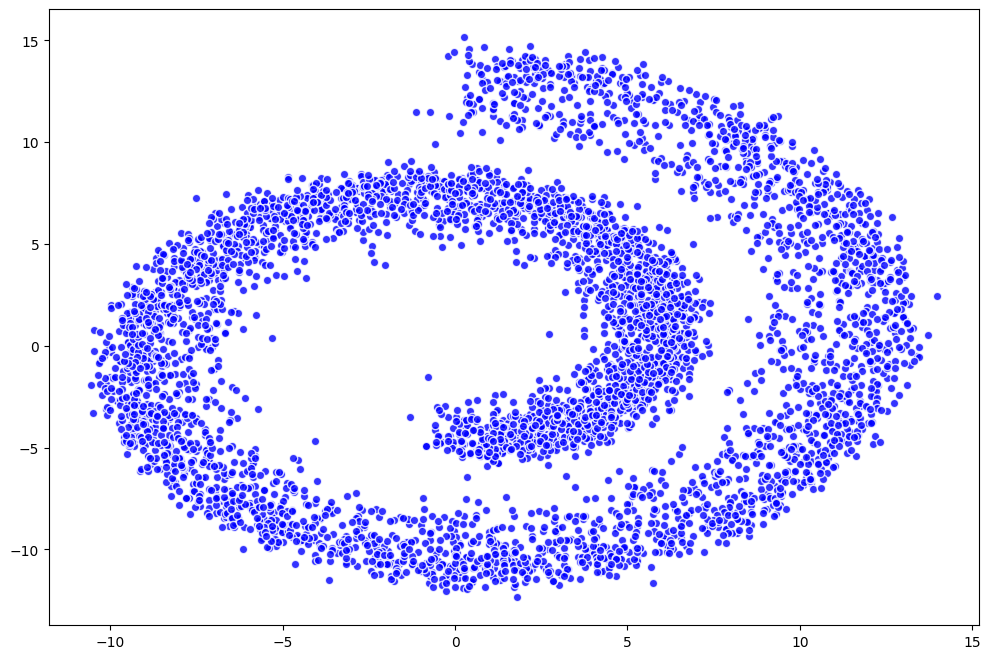

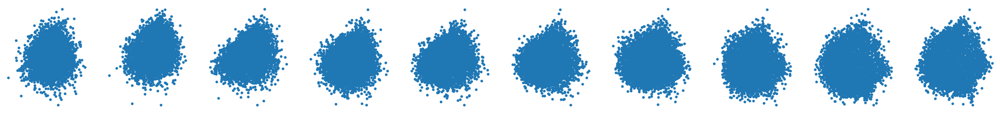

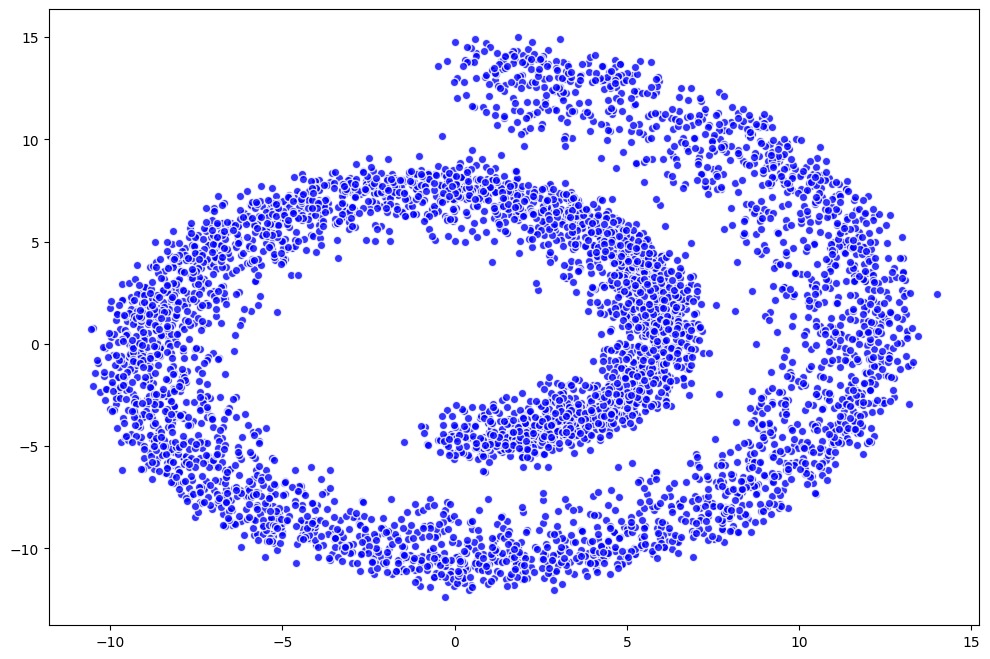

...

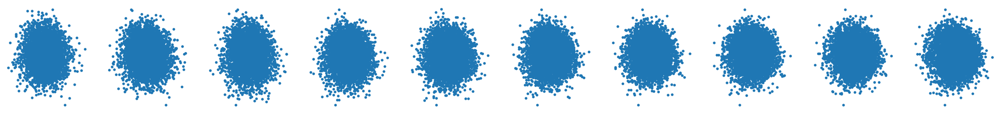

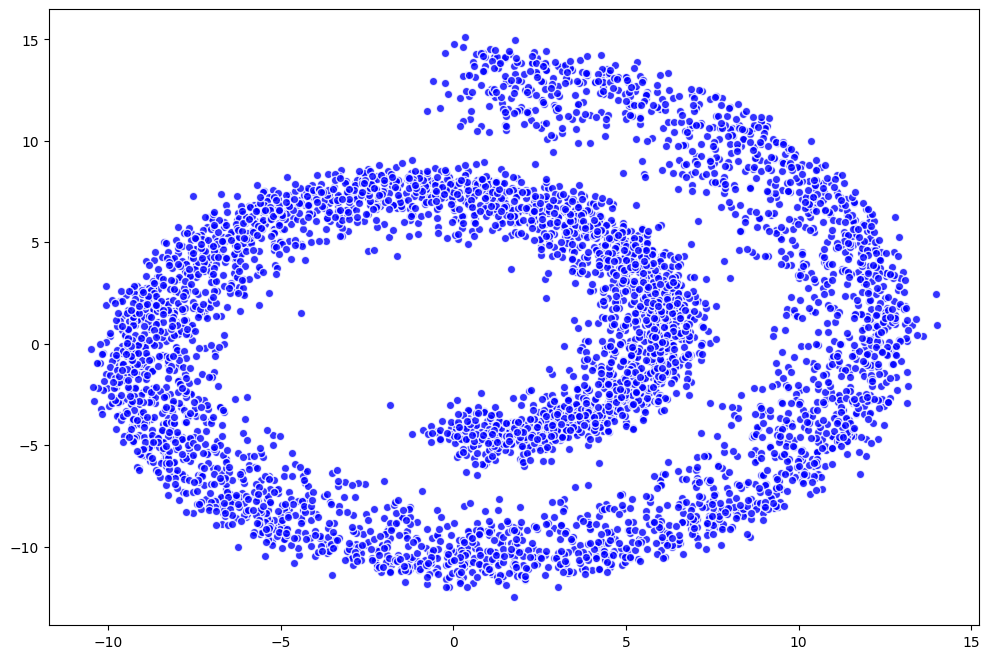

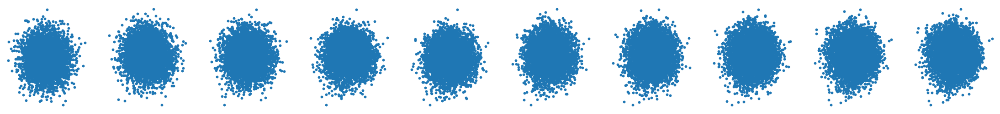

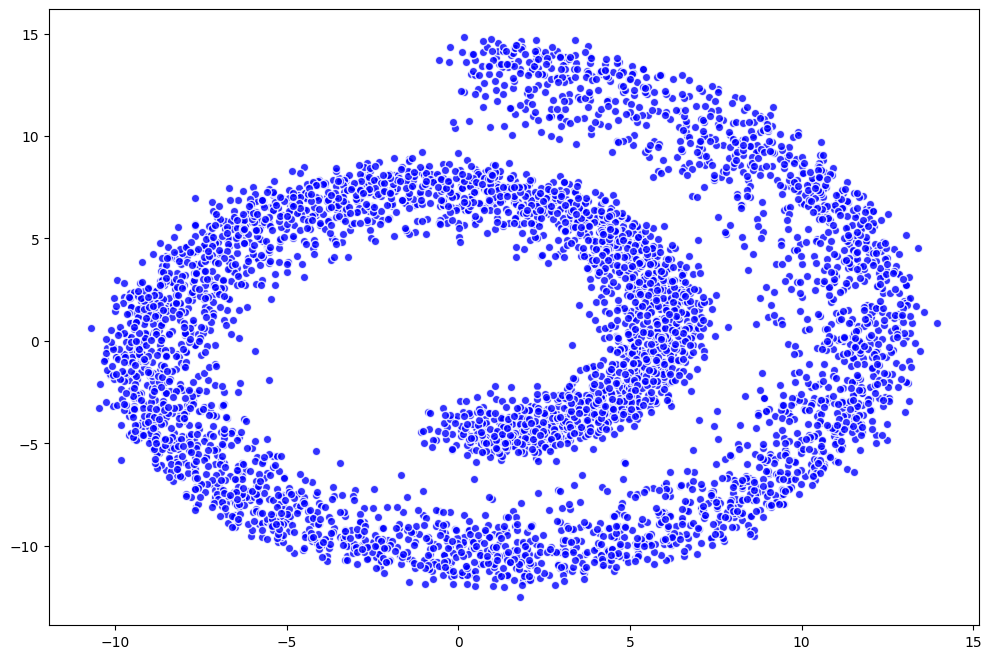

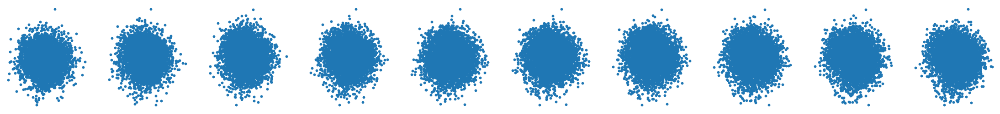

In [92]:
# 1 hr 17 mins to run

SGD_loss_vals = []
for t in range(n_epochs):
    # plt.figure(figsize=(12, 8))
    # plt.scatter(*dataset.T, alpha=0.8, color='blue', edgecolor='white');
    noisy_data = torch.empty(0,2)
    epoch_loss= []
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, x_t = loss_likelihood_bound(model, batch_x)
        noisy_data = torch.cat((noisy_data, x_t), 0)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        epoch_loss.append(loss.item())
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
    if (t % 100 == 0):
        SGD_loss_vals.append(sum(epoch_loss)/len(epoch_loss))
    # Print loss
    if (t % 1000 == 0):
        print("Loss at epoch " + str(t) + ": " + str(loss.item()))
        plt.figure(figsize=(12, 8))
        plt.scatter(*noisy_data.T, alpha=0.8, color='blue', edgecolor='white');
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); # axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')

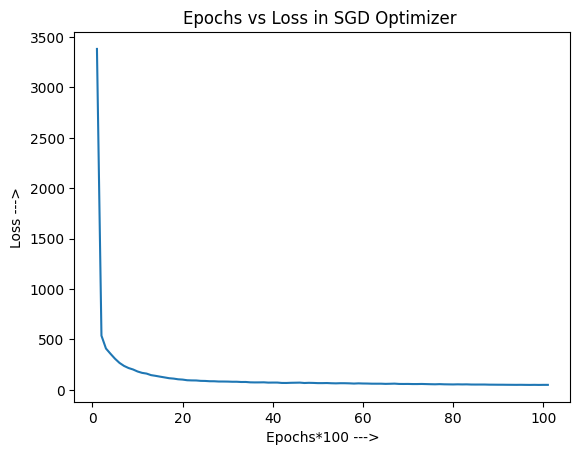

In [93]:
x_label = "Epochs*100 --->"
y_label = "Loss --->"
title = "Epochs vs Loss in SGD Optimizer with moemntum lr = 1e-4"
my_plot(np.linspace(1, len(SGD_loss_vals), len(SGD_loss_vals)).astype(int), SGD_loss_vals, x_label, y_label, title)

***The curve is more smoother here***

#***SGD optimizer with lr=1e-3 momentum = 0.9 and ExponentialLR scheduler***

In [94]:
dataset = torch.tensor(data.T).float()
model = ConditionalModel(n_time_steps)
optimizer = optim.SGD(model.parameters(), lr=1e-3, momentum = 0.9)
ExponentialLR_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.01)
batch_size = 128
n_epochs = 10001

Loss at epoch 0: 4110.3837890625
Loss at epoch 1000: 4071.190185546875
Loss at epoch 2000: 4443.24072265625
Loss at epoch 3000: 3798.31689453125
Loss at epoch 4000: 3873.771240234375
Loss at epoch 5000: 4005.154296875
Loss at epoch 6000: 4211.37451171875
Loss at epoch 7000: 4028.952392578125
Loss at epoch 8000: 4298.39794921875
Loss at epoch 9000: 4088.236328125
Loss at epoch 10000: 3742.002685546875


<ipython-input-96-2f898830e4dc>:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 8))


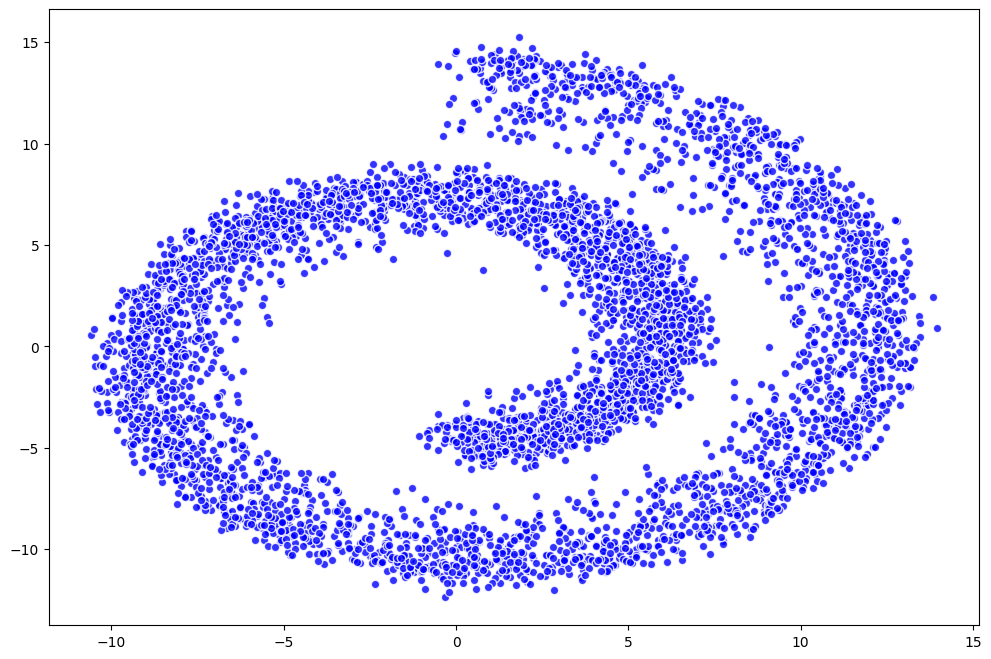

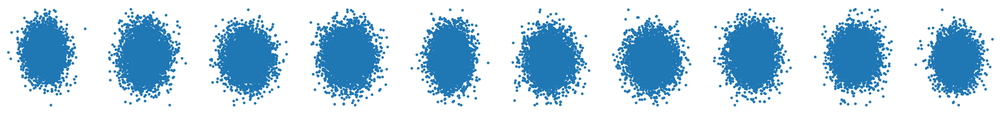

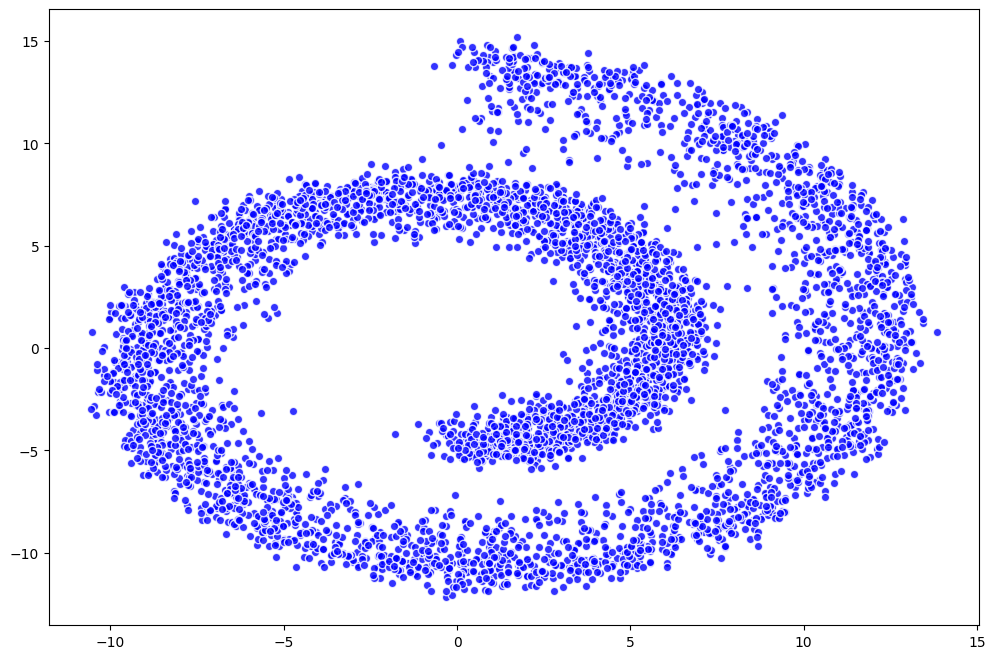

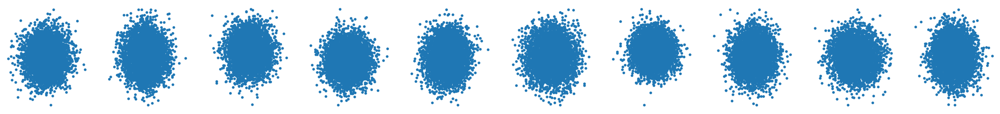

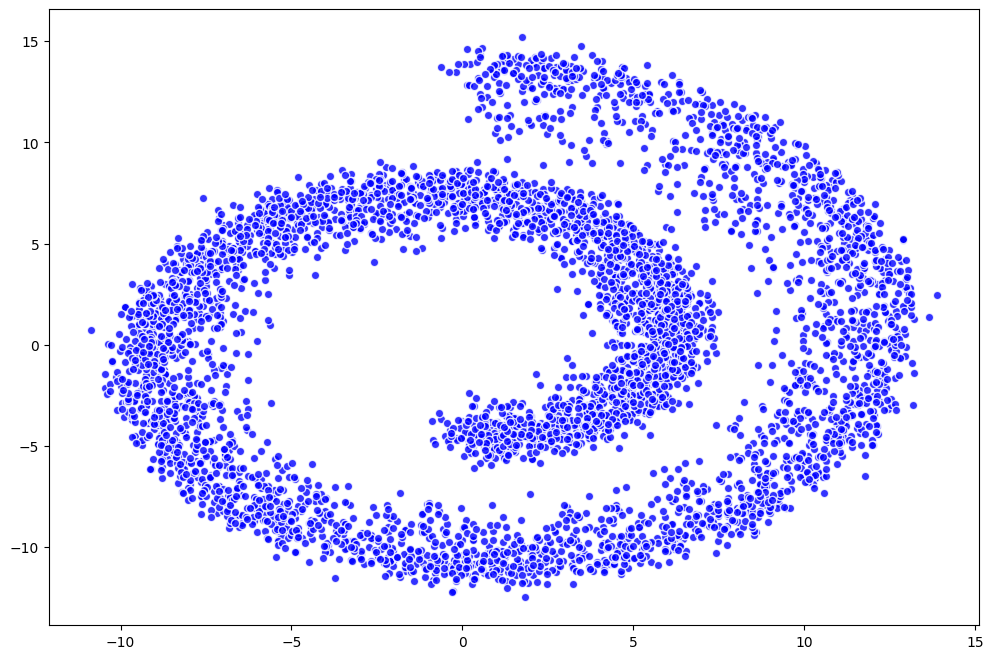

...

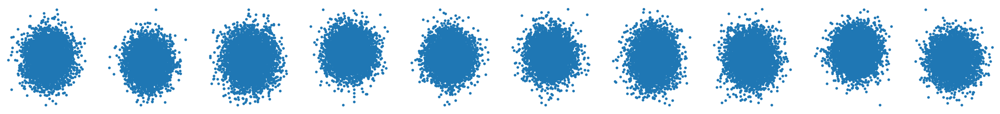

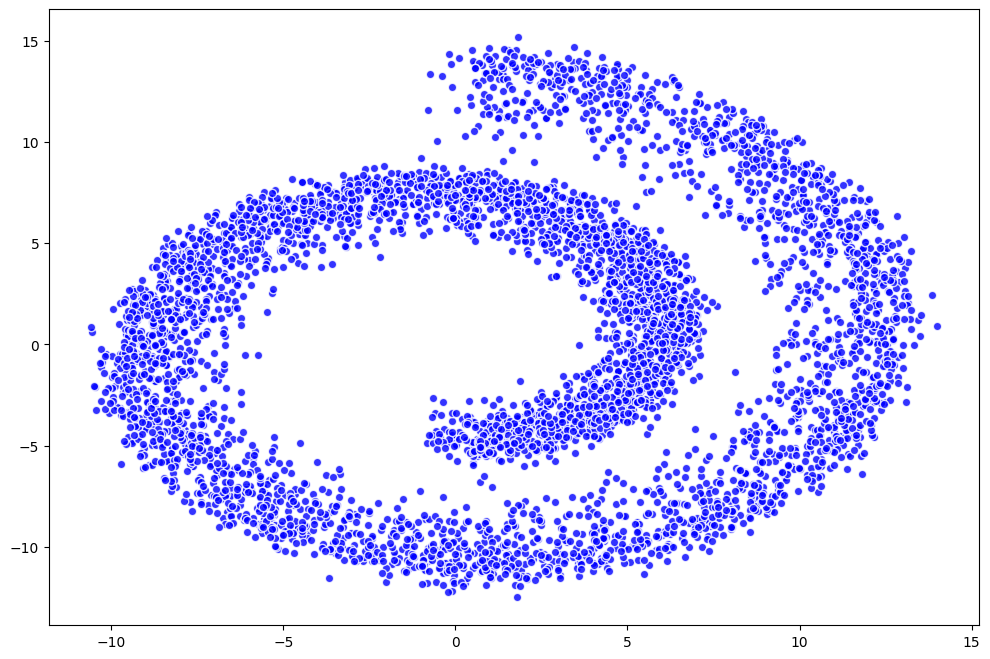

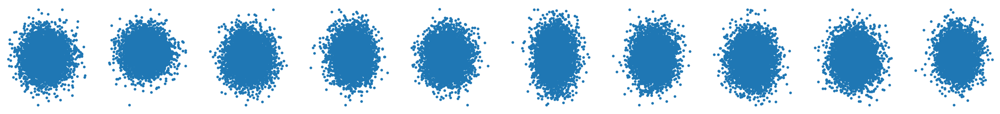

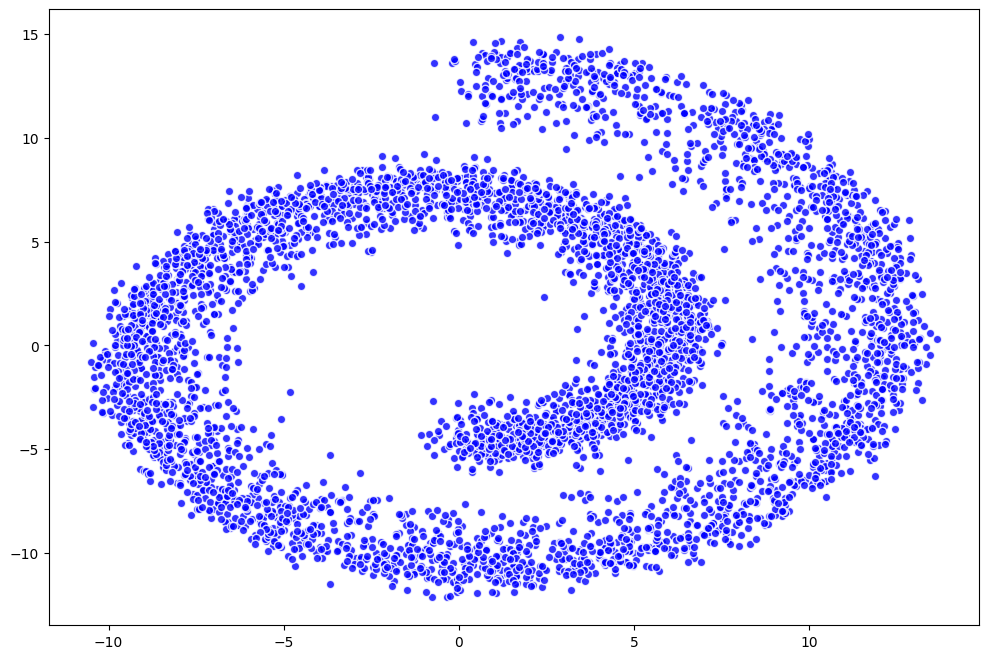

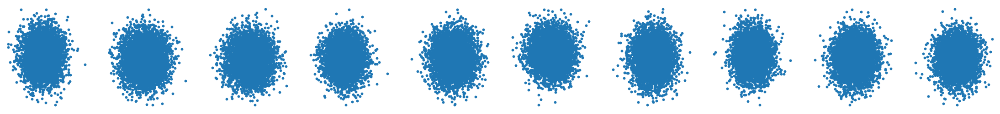

In [96]:
# 1 hr 17 mins to run

SGD_loss_vals = []
for t in range(n_epochs):
    # plt.figure(figsize=(12, 8))
    # plt.scatter(*dataset.T, alpha=0.8, color='blue', edgecolor='white');
    noisy_data = torch.empty(0,2)
    epoch_loss= []
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, x_t = loss_likelihood_bound(model, batch_x)
        noisy_data = torch.cat((noisy_data, x_t), 0)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        epoch_loss.append(loss.item())
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
        ExponentialLR_scheduler.step(loss)
    if (t % 100 == 0):
        SGD_loss_vals.append(sum(epoch_loss)/len(epoch_loss))
    # Print loss
    if (t % 1000 == 0):
        print("Loss at epoch " + str(t) + ": " + str(loss.item()))
        plt.figure(figsize=(12, 8))
        plt.scatter(*noisy_data.T, alpha=0.8, color='blue', edgecolor='white');
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); # axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')

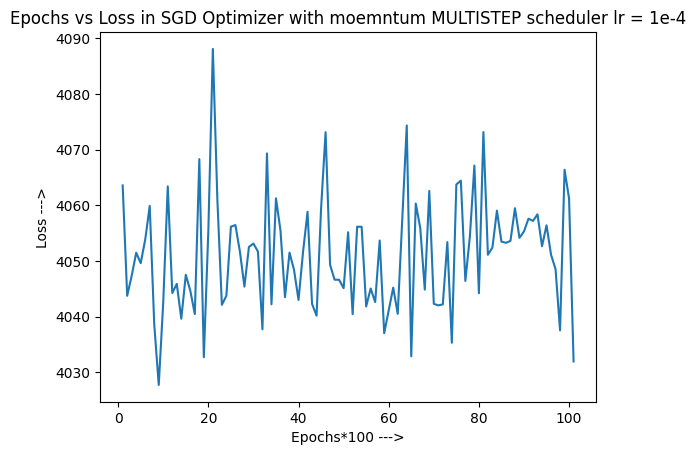

In [97]:
x_label = "Epochs*100 --->"
y_label = "Loss --->"
title = "Epochs vs Loss in SGD Optimizer with moemntum MULTISTEP scheduler lr = 1e-4"
my_plot(np.linspace(1, len(SGD_loss_vals), len(SGD_loss_vals)).astype(int), SGD_loss_vals, x_label, y_label, title)

***Exponential Schedluer LR not performing so well, lot of fluctuations in graph***

Trying with cosine formula beta value, refer other notebook.<br>
Giving very good results.<br>
Loss are much lower.<br>

# ***BEST RESULT ON SIGMOID/LINEAR betas***

tensor(370.0294, grad_fn=<MeanBackward0>)
tensor(47.4607, grad_fn=<MeanBackward0>)
tensor(50.3694, grad_fn=<MeanBackward0>)
tensor(26.6281, grad_fn=<MeanBackward0>)
tensor(34.5989, grad_fn=<MeanBackward0>)
tensor(41.3670, grad_fn=<MeanBackward0>)


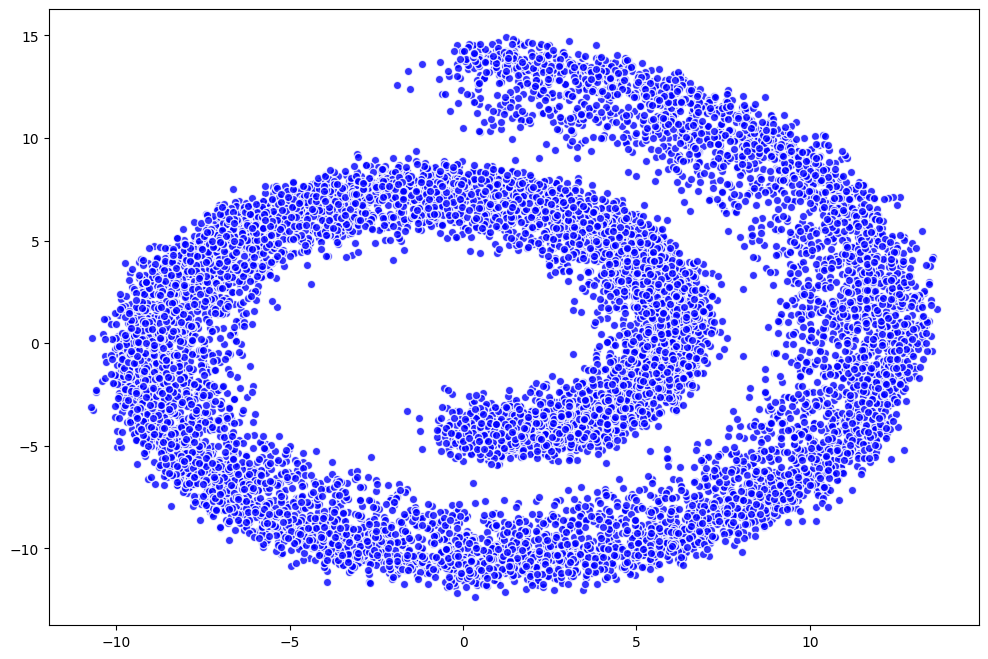

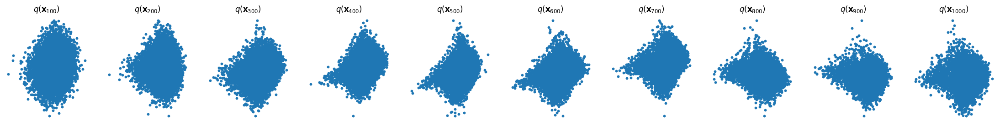

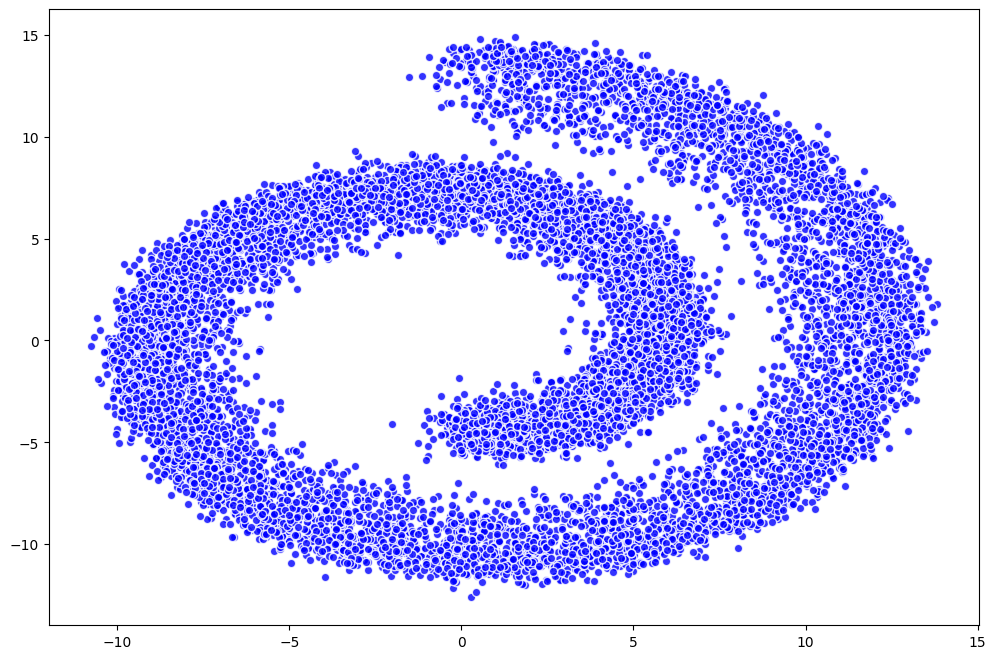

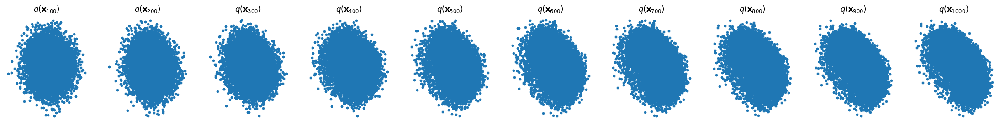

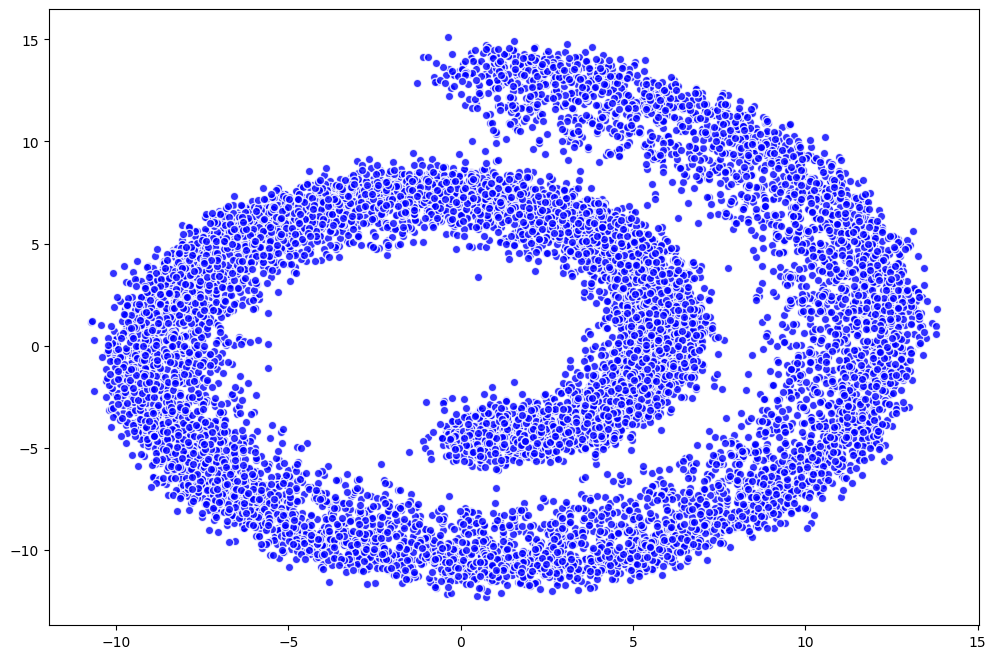

...

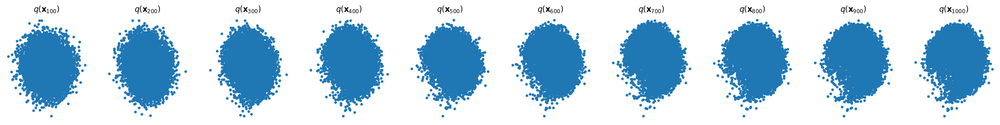

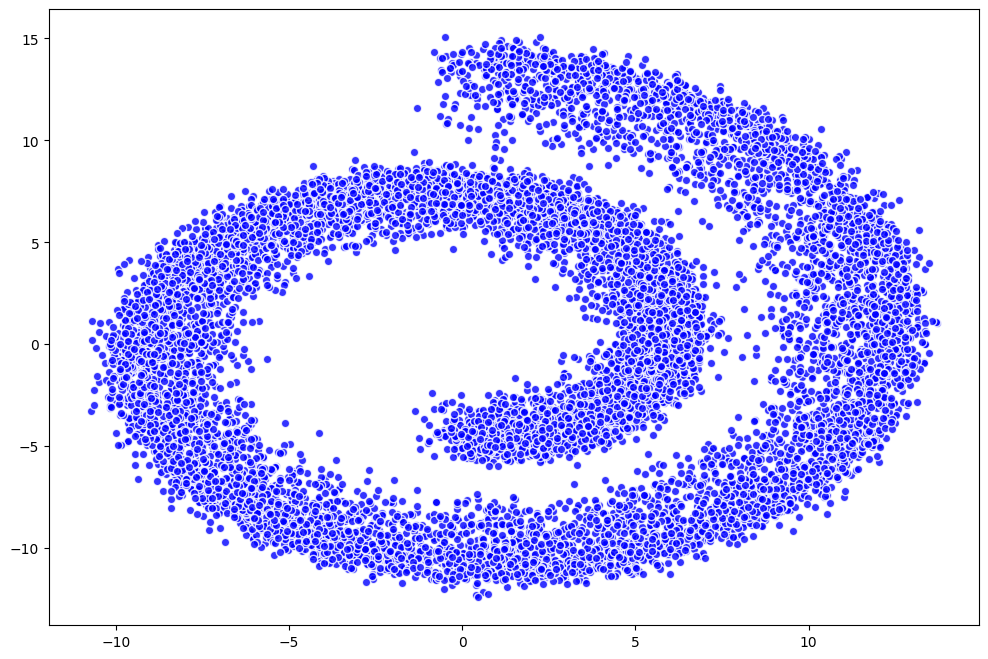

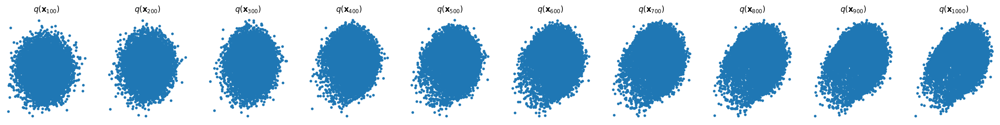

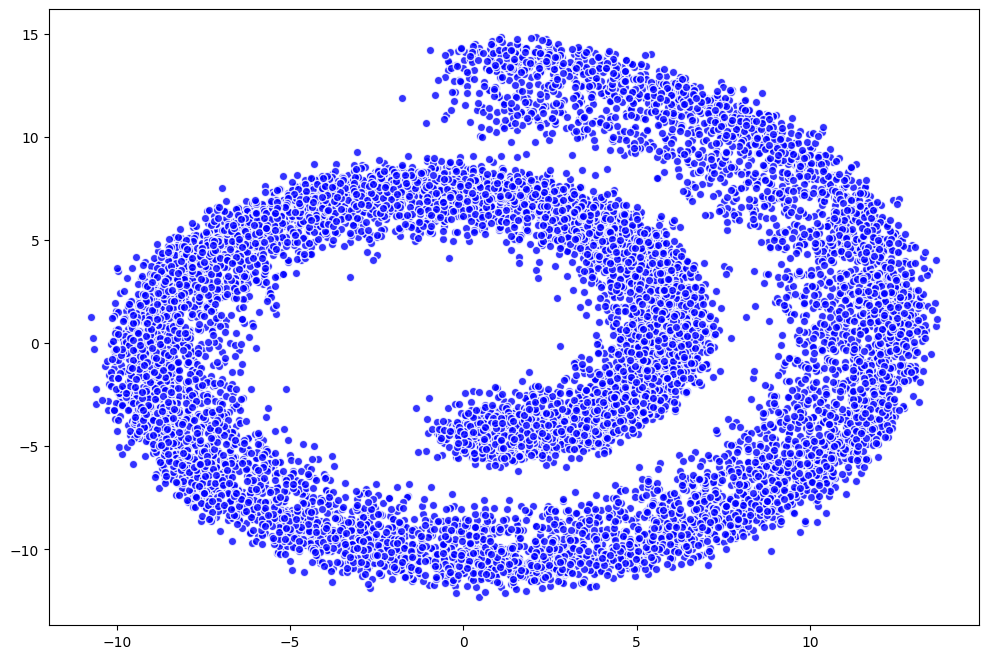

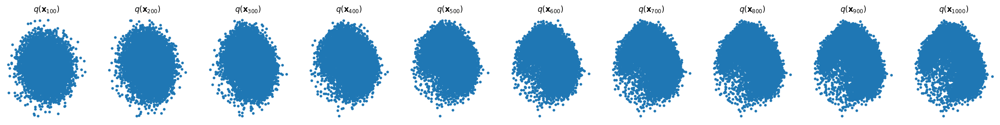

In [ ]:
# 0 hr 45 mins to run
model = ConditionalModel(n_time_steps)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
dataset = torch.tensor(data.T).float()
batch_size = 128

# noisy_data = torch.empty(0,2)

for t in range(5001):
    plt.figure(figsize=(12, 8))
    plt.scatter(*dataset.T, alpha=0.8, color='blue', edgecolor='white');
    noisy_data = torch.empty(0,2)
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, x_t = loss_likelihood_bound(model, batch_x)
        noisy_data = torch.cat((noisy_data, x_t), 0)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
    # Print loss
    if (t % 1000 == 0):
        print(loss)
        plt.figure(figsize=(12, 8))
        plt.scatter(*noisy_data.T, alpha=0.8, color='blue', edgecolor='white');
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')

tensor(490.8990, grad_fn=<MeanBackward0>)
tensor(68.1248, grad_fn=<MeanBackward0>)
tensor(31.0192, grad_fn=<MeanBackward0>)
tensor(40.7742, grad_fn=<MeanBackward0>)
tensor(45.8241, grad_fn=<MeanBackward0>)
tensor(34.9182, grad_fn=<MeanBackward0>)
tensor(76.3315, grad_fn=<MeanBackward0>)
tensor(35.1542, grad_fn=<MeanBackward0>)
tensor(34.6745, grad_fn=<MeanBackward0>)
tensor(19.0957, grad_fn=<MeanBackward0>)
tensor(30.2526, grad_fn=<MeanBackward0>)
tensor(22.6117, grad_fn=<MeanBackward0>)
tensor(30.8988, grad_fn=<MeanBackward0>)
tensor(22.5637, grad_fn=<MeanBackward0>)
tensor(15.1312, grad_fn=<MeanBackward0>)
tensor(8.1209, grad_fn=<MeanBackward0>)
tensor(11.5927, grad_fn=<MeanBackward0>)
tensor(45.9641, grad_fn=<MeanBackward0>)
tensor(30.3541, grad_fn=<MeanBackward0>)
tensor(9.9741, grad_fn=<MeanBackward0>)
tensor(49.7782, grad_fn=<MeanBackward0>)


<ipython-input-23-b251c6f19982>:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 10, figsize=(28, 3))


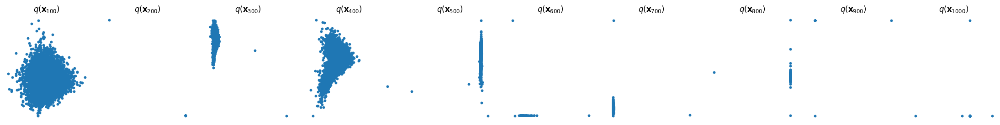

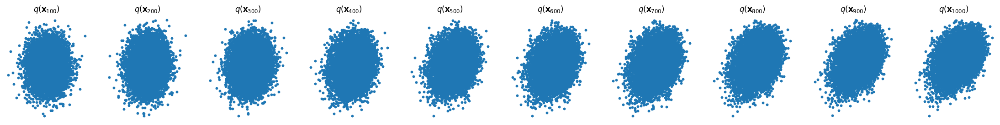

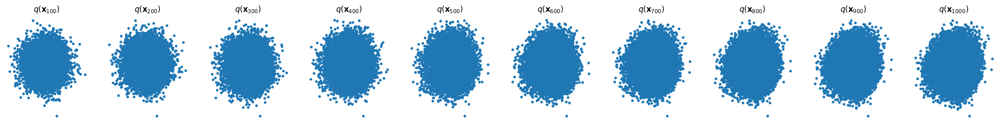

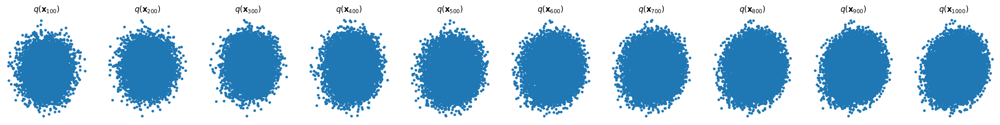

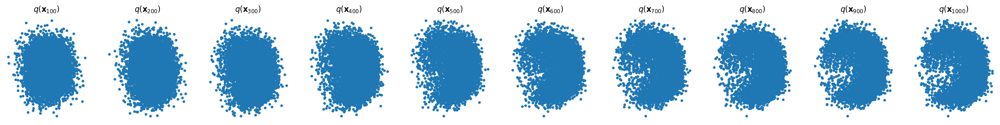

...

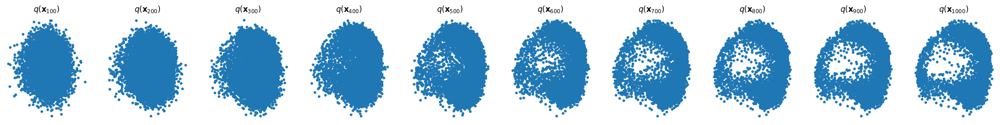

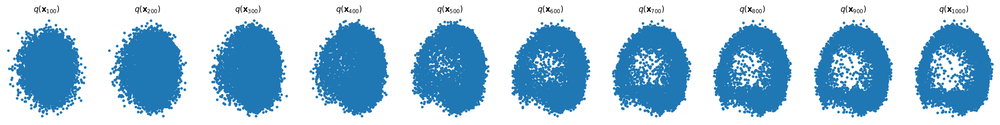

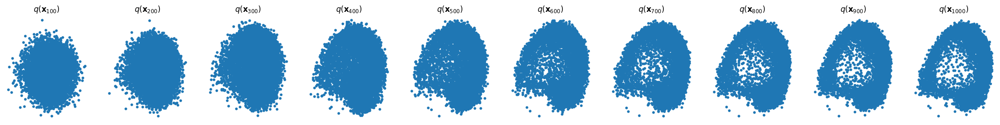

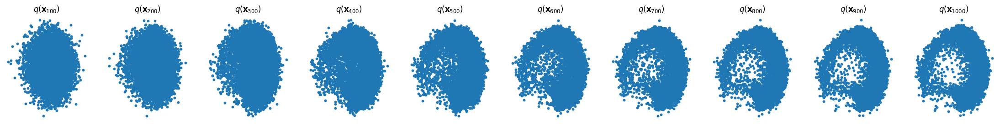

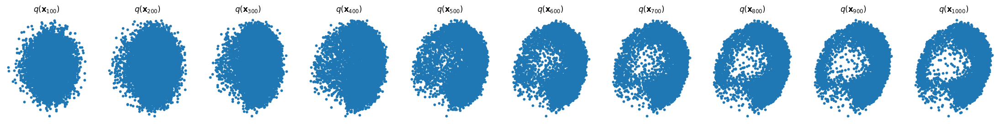

In [ ]:
# 3 hr 0 mins to run
model = ConditionalModel(n_time_steps)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
dataset = torch.tensor(data.T).float()
batch_size = 128
for t in range(20001):
    # X is a torch Variable
    permutation = torch.randperm(dataset.size()[0])
    for i in range(0, dataset.size()[0], batch_size):
        # Retrieve current batch
        indices = permutation[i:i+batch_size]
        batch_x = dataset[indices]
        # Compute the loss.
        loss, _ = loss_likelihood_bound(model, batch_x)
        # Before the backward pass, zero all of the network gradients
        optimizer.zero_grad()
        # Backward pass: compute gradient of the loss with respect to parameters
        loss.backward()
        # Perform gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.)
        # Calling the step function to update the parameters
        optimizer.step()
    # Print loss
    if (t % 1000 == 0):
        print(loss)
        x_seq = p_sample_loop(model, dataset.shape)
        fig, axs = plt.subplots(1, 10, figsize=(28, 3))
        for i in range(1, 11):
            cur_x = x_seq[i * 10].detach()
            axs[i-1].scatter(cur_x[:, 0], cur_x[:, 1], s=10);
            axs[i-1].set_axis_off(); axs[i-1].set_title('$q(\mathbf{x}_{'+str(i*100)+'})$')